In [ ]:
#LIBRERIAS
import os
import random
from PIL import Image
import matplotlib.pyplot as plt
from sklearn.model_selection import train_test_split
import torch
from torch.utils.data import DataLoader, TensorDataset
from tqdm import tqdm
import numpy as np
import torch.nn as nn
import torch.nn.functional as F
from tqdm import tqdm
from sklearn.metrics import jaccard_score
from sklearn.metrics import accuracy_score

print("Number of GPU: ", torch.cuda.device_count())
print("GPU Name: ", torch.cuda.get_device_name())



device = torch.device('cuda' if torch.cuda.is_available() else 'cpu')
print('Using device:', device)

Number of GPU:  1
GPU Name:  NVIDIA GeForce RTX 3060
Using device: cuda


Carga de informacion

In [2]:
sat_npy=np.load(r"Input\f_sat.npy")
mas_npy=np.load(r"Input\f_mask.npy")

X_train,X_test,Y_train,Y_test = train_test_split(sat_npy, mas_npy,train_size=0.8,random_state=42)

del sat_npy, mas_npy

In [3]:
Y_train=np.where(Y_train != 0, 1, 0)
Y_test=np.where(Y_test != 0, 1, 0)
Y_test_clas=np.where(Y_test == 3, 0, 0)

Creacion de modelo

In [7]:
# Bloque de atención
class AttentionBlock(nn.Module):
    def __init__(self, F_g, F_l, F_int):
        super(AttentionBlock, self).__init__()
        self.W_g = nn.Sequential(
            nn.Conv2d(F_g, F_int, kernel_size=1, stride=1, padding=0, bias=True),
            nn.BatchNorm2d(F_int)
        )

        self.W_x = nn.Sequential(
            nn.Conv2d(F_l, F_int, kernel_size=1, stride=1, padding=0, bias=True),
            nn.BatchNorm2d(F_int)
        )

        self.psi = nn.Sequential(
            nn.Conv2d(F_int, 1, kernel_size=1, stride=1, padding=0, bias=True),
            nn.BatchNorm2d(1),
            nn.Sigmoid()
        )

        self.relu = nn.ReLU(inplace=True)

    def forward(self, g, x):
        g1 = self.W_g(g)
        x1 = self.W_x(x)
        psi = self.relu(g1 + x1)
        psi = self.psi(psi)
        return x * psi


# Bloque de convolución doble
class ConvBlock(nn.Module):
    def __init__(self, in_channels, out_channels):
        super(ConvBlock, self).__init__()
        self.conv = nn.Sequential(
            nn.Conv2d(in_channels, out_channels, kernel_size=3, padding=1, stride=1),
            nn.BatchNorm2d(out_channels),
            nn.ReLU(inplace=True),
            nn.Conv2d(out_channels, out_channels, kernel_size=3, padding=1, stride=1),
            nn.BatchNorm2d(out_channels),
            nn.ReLU(inplace=True)
        )

    def forward(self, x):
        return self.conv(x)


# Modelo Attention U-Net
class AttentionUNet(nn.Module):
    def __init__(self, input_channels, output_channels):
        super(AttentionUNet, self).__init__()

        # Encoder
        self.enc1 = ConvBlock(input_channels, 64)
        self.pool1 = nn.MaxPool2d(kernel_size=2, stride=2)
        self.enc2 = ConvBlock(64, 128)
        self.pool2 = nn.MaxPool2d(kernel_size=2, stride=2)
        self.enc3 = ConvBlock(128, 256)
        self.pool3 = nn.MaxPool2d(kernel_size=2, stride=2)
        self.enc4 = ConvBlock(256, 512)
        self.pool4 = nn.MaxPool2d(kernel_size=2, stride=2)

        # Bottleneck
        self.bottleneck = ConvBlock(512, 1024)

        # Decoder
        self.up4 = nn.ConvTranspose2d(1024, 512, kernel_size=2, stride=2)
        self.att4 = AttentionBlock(F_g=512, F_l=512, F_int=256)
        self.dec4 = ConvBlock(1024, 512)

        self.up3 = nn.ConvTranspose2d(512, 256, kernel_size=2, stride=2)
        self.att3 = AttentionBlock(F_g=256, F_l=256, F_int=128)
        self.dec3 = ConvBlock(512, 256)

        self.up2 = nn.ConvTranspose2d(256, 128, kernel_size=2, stride=2)
        self.att2 = AttentionBlock(F_g=128, F_l=128, F_int=64)
        self.dec2 = ConvBlock(256, 128)

        self.up1 = nn.ConvTranspose2d(128, 64, kernel_size=2, stride=2)
        self.att1 = AttentionBlock(F_g=64, F_l=64, F_int=32)
        self.dec1 = ConvBlock(128, 64)

        # Salida
        self.out = nn.Conv2d(64, output_channels, kernel_size=1, stride=1)

    def forward(self, x):
        # Encoder
        enc1 = self.enc1(x)
        enc2 = self.enc2(self.pool1(enc1))
        enc3 = self.enc3(self.pool2(enc2))
        enc4 = self.enc4(self.pool3(enc3))

        # Bottleneck
        bottleneck = self.bottleneck(self.pool4(enc4))

        # Decoder
        up4 = self.up4(bottleneck)
        att4 = self.att4(up4, enc4)
        dec4 = self.dec4(torch.cat([up4, att4], dim=1))

        up3 = self.up3(dec4)
        att3 = self.att3(up3, enc3)
        dec3 = self.dec3(torch.cat([up3, att3], dim=1))

        up2 = self.up2(dec3)
        att2 = self.att2(up2, enc2)
        dec2 = self.dec2(torch.cat([up2, att2], dim=1))

        up1 = self.up1(dec2)
        att1 = self.att1(up1, enc1)
        dec1 = self.dec1(torch.cat([up1, att1], dim=1))

        out = self.out(dec1)

        return out


# Instanciar el modelo
model = AttentionUNet(input_channels=3, output_channels=1)  # Para imágenes RGB y una clase de salida
print(model)

AttentionUNet(
  (enc1): ConvBlock(
    (conv): Sequential(
      (0): Conv2d(3, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
      (1): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
      (2): ReLU(inplace=True)
      (3): Conv2d(64, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
      (4): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
      (5): ReLU(inplace=True)
    )
  )
  (pool1): MaxPool2d(kernel_size=2, stride=2, padding=0, dilation=1, ceil_mode=False)
  (enc2): ConvBlock(
    (conv): Sequential(
      (0): Conv2d(64, 128, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
      (1): BatchNorm2d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
      (2): ReLU(inplace=True)
      (3): Conv2d(128, 128, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
      (4): BatchNorm2d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
      (5): ReLU(inplace=True)
   

Arreglo para solo dos clases

### Entrenamiento

In [5]:
X_train_tensor = torch.tensor(X_train, dtype=torch.float32).permute(0, 3, 1, 2)  # [N, C, H, W]
y_train_tensor = torch.tensor(Y_train, dtype=torch.long)  # [N, H, W]

X_test_tensor = torch.tensor(X_test, dtype=torch.float32).permute(0, 3, 1, 2)  # [N, C, H, W]
y_test_tensor = torch.tensor(Y_test, dtype=torch.long)  # [N, H, W]
# Crear Dataset y DataLoader para validación
val_dataset = TensorDataset(X_test_tensor, y_test_tensor)
valid_loader = DataLoader(val_dataset, batch_size=8, shuffle=False, pin_memory=True)

# Crear el DataLoader
train_dataset = TensorDataset(X_train_tensor, y_train_tensor)
train_loader = DataLoader(train_dataset, batch_size=8, shuffle=True, pin_memory=True)

# Definir el modelo
model = AttentionUNet(input_channels=3, output_channels=2)  # Cambia output_channels según el número de clases
optimizer = torch.optim.Adam(model.parameters(), lr=0.001)
criterion = torch.nn.CrossEntropyLoss()

# Configurar dispositivo
device = torch.device('cuda' if torch.cuda.is_available() else 'cpu')
print(f"Using device: {device}")

# Mover el modelo a la GPU
model = model.to(device)

Using device: cuda


In [ ]:
# Early stopping
patience = 3  # Número de épocas a esperar antes de detener si no mejora
best_val_loss = float('inf')
epochs_without_improvement = 0

# Entrenamiento con early stopping
for epoch in tqdm(range(50), desc="Epochs"):  
    model.train()  # Modo de entrenamiento
    train_loss = 0.0
    for batch_idx, (images, masks) in enumerate(tqdm(train_loader, desc="Batches", leave=False)):
        images, masks = images.to(device), masks.to(device)
        optimizer.zero_grad()
        outputs = model(images)
        loss = criterion(outputs, masks)
        loss.backward()
        optimizer.step()

        train_loss += loss.item()

        if batch_idx % 10 == 0:
            print(f"Epoch {epoch+1}, Batch {batch_idx}, Loss: {loss.item():.4f}")

        # Liberar memoria del batch
        del images, masks, outputs, loss
        torch.cuda.empty_cache()  # Limpiar memoria de GPU

    train_loss /= len(train_loader)  # Pérdida promedio en el entrenamiento
    print(f"Epoch {epoch+1} finalizada. Pérdida en entrenamiento: {train_loss:.4f}")

    # Validación
    model.eval()
    val_loss = 0.0
    with torch.no_grad():
        for images, masks in valid_loader:
            images, masks = images.to(device), masks.to(device)
            outputs = model(images)
            loss = criterion(outputs, masks)
            val_loss += loss.item()
            
            del images, masks, outputs, loss
            torch.cuda.empty_cache()

    val_loss /= len(valid_loader)  # Pérdida promedio en validación
    print(f"Epoch {epoch+1} finalizada. Pérdida en validación: {val_loss:.4f}")

    # Early stopping
    if val_loss < best_val_loss:
        best_val_loss = val_loss
        epochs_without_improvement = 0
    else:
        epochs_without_improvement += 1
        print(f"Sin mejora durante {epochs_without_improvement} épocas consecutivas.")
        if epochs_without_improvement >= patience:
            print("Criterio de early stopping alcanzado. Deteniendo entrenamiento.")
            break

print("Entrenamiento completado.")

Epochs:   0%|          | 0/50 [00:00<?, ?it/s]

Epoch 1, Batch 0, Loss: 0.8575


Epoch 1, Batch 10, Loss: 0.6629


Epoch 1, Batch 20, Loss: 0.6640


Epoch 1, Batch 30, Loss: 0.6771


Epoch 1, Batch 40, Loss: 0.6197


Epoch 1, Batch 50, Loss: 0.6713


Epoch 1, Batch 60, Loss: 0.5861


Epoch 1, Batch 70, Loss: 0.6459


Epoch 1, Batch 80, Loss: 0.6038


Epoch 1, Batch 90, Loss: 0.6323


Epoch 1, Batch 100, Loss: 0.6070


Epoch 1, Batch 110, Loss: 0.6051


Epoch 1, Batch 120, Loss: 0.6328


Epoch 1, Batch 130, Loss: 0.6621


Epoch 1, Batch 140, Loss: 0.6359


Epoch 1, Batch 150, Loss: 0.6153


Epoch 1, Batch 160, Loss: 0.5660


Epoch 1, Batch 170, Loss: 0.6630


Epoch 1, Batch 180, Loss: 0.6021


Epoch 1, Batch 190, Loss: 0.5852


Epoch 1, Batch 200, Loss: 0.6813


Epoch 1, Batch 210, Loss: 0.6033


Epoch 1, Batch 220, Loss: 0.6313


Epoch 1, Batch 230, Loss: 0.6349


Epoch 1, Batch 240, Loss: 0.5483


Epoch 1, Batch 250, Loss: 0.6282


Epoch 1, Batch 260, Loss: 0.6075


Epoch 1, Batch 270, Loss: 0.5767


Epoch 1, Batch 280, Loss: 0.6609


Epoch 1, Batch 290, Loss: 0.6113


Epoch 1, Batch 300, Loss: 0.6422


Epoch 1, Batch 310, Loss: 0.6385


Epoch 1, Batch 320, Loss: 0.5595


Epoch 1, Batch 330, Loss: 0.5969


Epoch 1, Batch 340, Loss: 0.5747


Epoch 1, Batch 350, Loss: 0.5867


Epoch 1, Batch 360, Loss: 0.6092


Epoch 1, Batch 370, Loss: 0.5836


Epoch 1, Batch 380, Loss: 0.5851


Epoch 1, Batch 390, Loss: 0.6004


Epoch 1, Batch 400, Loss: 0.6349


Epoch 1, Batch 410, Loss: 0.5649


Epoch 1, Batch 420, Loss: 0.6039


Epoch 1, Batch 430, Loss: 0.6375


Epoch 1, Batch 440, Loss: 0.5642


Epoch 1, Batch 450, Loss: 0.7212


Epoch 1, Batch 460, Loss: 0.5850


Epoch 1, Batch 470, Loss: 0.5768


Epoch 1, Batch 480, Loss: 0.5539


Epoch 1, Batch 490, Loss: 0.5018


Epoch 1, Batch 500, Loss: 0.6131


Epoch 1, Batch 510, Loss: 0.5463


Epoch 1, Batch 520, Loss: 0.6275


Epoch 1, Batch 530, Loss: 0.5756


Epoch 1, Batch 540, Loss: 0.5209


Epoch 1, Batch 550, Loss: 0.5895


Epoch 1, Batch 560, Loss: 0.6039


Epoch 1, Batch 570, Loss: 0.6705


Epoch 1, Batch 580, Loss: 0.5686


Epoch 1, Batch 590, Loss: 0.5630


Epoch 1, Batch 600, Loss: 0.4658


Epoch 1, Batch 610, Loss: 0.5226


Epoch 1, Batch 620, Loss: 0.5424


Epoch 1, Batch 630, Loss: 0.6438


Epoch 1, Batch 640, Loss: 0.5848


Epoch 1, Batch 650, Loss: 0.5109


Epoch 1, Batch 660, Loss: 0.6635


Epoch 1, Batch 670, Loss: 0.5859


Epoch 1, Batch 680, Loss: 0.5336


Epoch 1, Batch 690, Loss: 0.4735


Epoch 1, Batch 700, Loss: 0.4865


Epoch 1, Batch 710, Loss: 0.5197


Epoch 1, Batch 720, Loss: 0.5091


Epoch 1, Batch 730, Loss: 0.5292


Epoch 1, Batch 740, Loss: 0.4839


Epoch 1, Batch 750, Loss: 0.6081


Epoch 1, Batch 760, Loss: 0.5263


Epoch 1, Batch 770, Loss: 0.5660


Epoch 1, Batch 780, Loss: 0.4807


Epoch 1, Batch 790, Loss: 0.5282


Epoch 1, Batch 800, Loss: 0.5581


Epoch 1, Batch 810, Loss: 0.4582


Epoch 1, Batch 820, Loss: 0.5530


Epoch 1, Batch 830, Loss: 0.5562


Epoch 1, Batch 840, Loss: 0.6805


Epoch 1, Batch 850, Loss: 0.5235


Epoch 1, Batch 860, Loss: 0.5421


Epoch 1, Batch 870, Loss: 0.6336


Epoch 1, Batch 880, Loss: 0.5039


Epoch 1, Batch 890, Loss: 0.4986


Epoch 1, Batch 900, Loss: 0.5187


Epoch 1, Batch 910, Loss: 0.4558


Epoch 1, Batch 920, Loss: 0.4508


Epoch 1, Batch 930, Loss: 0.5807


Epoch 1, Batch 940, Loss: 0.5231


Epoch 1, Batch 950, Loss: 0.5350


Epoch 1, Batch 960, Loss: 0.5050


Epoch 1, Batch 970, Loss: 0.4848


Epoch 1, Batch 980, Loss: 0.5181


Epoch 1, Batch 990, Loss: 0.6091


Epoch 1, Batch 1000, Loss: 0.5393


Epoch 1, Batch 1010, Loss: 0.5389


Epoch 1, Batch 1020, Loss: 0.5276


Epoch 1, Batch 1030, Loss: 0.5613


Epoch 1, Batch 1040, Loss: 0.5371


Epoch 1, Batch 1050, Loss: 0.4469


Epoch 1, Batch 1060, Loss: 0.7536


Epoch 1, Batch 1070, Loss: 0.5834


Epoch 1, Batch 1080, Loss: 0.5399


Epoch 1, Batch 1090, Loss: 0.5722


Epoch 1 finalizada. Pérdida en entrenamiento: 0.5763
Epoch 1 finalizada. Pérdida en validación: 0.5303
Modelo mejorado, guardado.


Epochs:   2%|▏         | 1/50 [08:09<6:40:07, 489.95s/it]

Epoch 2, Batch 0, Loss: 0.5643


Epoch 2, Batch 10, Loss: 0.5458


Epoch 2, Batch 20, Loss: 0.4864


Epoch 2, Batch 30, Loss: 0.5117


Epoch 2, Batch 40, Loss: 0.4659


Epoch 2, Batch 50, Loss: 0.6066


Epoch 2, Batch 60, Loss: 0.4936


Epoch 2, Batch 70, Loss: 0.6049


Epoch 2, Batch 80, Loss: 0.5030


Epoch 2, Batch 90, Loss: 0.4690


Epoch 2, Batch 100, Loss: 0.6285


Epoch 2, Batch 110, Loss: 0.4777


Epoch 2, Batch 120, Loss: 0.6315


Epoch 2, Batch 130, Loss: 0.4968


Epoch 2, Batch 140, Loss: 0.4991


Epoch 2, Batch 150, Loss: 0.7340


Epoch 2, Batch 160, Loss: 0.4665


Epoch 2, Batch 170, Loss: 0.5314


Epoch 2, Batch 180, Loss: 0.4438


Epoch 2, Batch 190, Loss: 0.5592


Epoch 2, Batch 200, Loss: 0.5240


Epoch 2, Batch 210, Loss: 0.5393


Epoch 2, Batch 220, Loss: 0.4374


Epoch 2, Batch 230, Loss: 0.5552


Epoch 2, Batch 240, Loss: 0.4908


Epoch 2, Batch 250, Loss: 0.5168


Epoch 2, Batch 260, Loss: 0.5106


Epoch 2, Batch 270, Loss: 0.5098


Epoch 2, Batch 280, Loss: 0.5437


Epoch 2, Batch 290, Loss: 0.5126


Epoch 2, Batch 300, Loss: 0.5032


Epoch 2, Batch 310, Loss: 0.4492


Epoch 2, Batch 320, Loss: 0.5256


Epoch 2, Batch 330, Loss: 0.5917


Epoch 2, Batch 340, Loss: 0.4936


Epoch 2, Batch 350, Loss: 0.5215


Epoch 2, Batch 360, Loss: 0.5022


Epoch 2, Batch 370, Loss: 0.5139


Epoch 2, Batch 380, Loss: 0.4459


Epoch 2, Batch 390, Loss: 0.4415


Epoch 2, Batch 400, Loss: 0.4960


Epoch 2, Batch 410, Loss: 0.4508


Epoch 2, Batch 420, Loss: 0.4853


Epoch 2, Batch 430, Loss: 0.5633


Epoch 2, Batch 440, Loss: 0.5499


Epoch 2, Batch 450, Loss: 0.5809


Epoch 2, Batch 460, Loss: 0.4883


Epoch 2, Batch 470, Loss: 0.5880


Epoch 2, Batch 480, Loss: 0.5377


Epoch 2, Batch 490, Loss: 0.4512


Epoch 2, Batch 500, Loss: 0.5377


Epoch 2, Batch 510, Loss: 0.5277


Epoch 2, Batch 520, Loss: 0.5174


Epoch 2, Batch 530, Loss: 0.4355


Epoch 2, Batch 540, Loss: 0.5331


Epoch 2, Batch 550, Loss: 0.6453


Epoch 2, Batch 560, Loss: 0.5214


Epoch 2, Batch 570, Loss: 0.4804


Epoch 2, Batch 580, Loss: 0.4751


Epoch 2, Batch 590, Loss: 0.4651


Epoch 2, Batch 600, Loss: 0.4827


Epoch 2, Batch 610, Loss: 0.5434


Epoch 2, Batch 620, Loss: 0.4801


Epoch 2, Batch 630, Loss: 0.5194


Epoch 2, Batch 640, Loss: 0.4272


Epoch 2, Batch 650, Loss: 0.4869


Epoch 2, Batch 660, Loss: 0.5299


Epoch 2, Batch 670, Loss: 0.5044


Epoch 2, Batch 680, Loss: 0.5500


Epoch 2, Batch 690, Loss: 0.6801


Epoch 2, Batch 700, Loss: 0.5695


Epoch 2, Batch 710, Loss: 0.5164


Epoch 2, Batch 720, Loss: 0.5171


Epoch 2, Batch 730, Loss: 0.4324


Epoch 2, Batch 740, Loss: 0.4496


Epoch 2, Batch 750, Loss: 0.5038


Epoch 2, Batch 760, Loss: 0.6035


Epoch 2, Batch 770, Loss: 0.4464


Epoch 2, Batch 780, Loss: 0.5060


Epoch 2, Batch 790, Loss: 0.5442


Epoch 2, Batch 800, Loss: 0.5168


Epoch 2, Batch 810, Loss: 0.4807


Epoch 2, Batch 820, Loss: 0.4812


Epoch 2, Batch 830, Loss: 0.6258


Epoch 2, Batch 840, Loss: 0.5521


Epoch 2, Batch 850, Loss: 0.5440


Epoch 2, Batch 860, Loss: 0.5352


Epoch 2, Batch 870, Loss: 0.5637


Epoch 2, Batch 880, Loss: 0.4025


Epoch 2, Batch 890, Loss: 0.5276


Epoch 2, Batch 900, Loss: 0.5068


Epoch 2, Batch 910, Loss: 0.4724


Epoch 2, Batch 920, Loss: 0.5226


Epoch 2, Batch 930, Loss: 0.5014


Epoch 2, Batch 940, Loss: 0.4279


Epoch 2, Batch 950, Loss: 0.4768


Epoch 2, Batch 960, Loss: 0.7171


Epoch 2, Batch 970, Loss: 0.5086


Epoch 2, Batch 980, Loss: 0.5357


Epoch 2, Batch 990, Loss: 0.5581


Epoch 2, Batch 1000, Loss: 0.5932


Epoch 2, Batch 1010, Loss: 0.5254


Epoch 2, Batch 1020, Loss: 0.4732


Epoch 2, Batch 1030, Loss: 0.4509


Epoch 2, Batch 1040, Loss: 0.4461


Epoch 2, Batch 1050, Loss: 0.5009


Epoch 2, Batch 1060, Loss: 0.4588


Epoch 2, Batch 1070, Loss: 0.4967


Epoch 2, Batch 1080, Loss: 0.4680


Epoch 2, Batch 1090, Loss: 0.5199


Epoch 2 finalizada. Pérdida en entrenamiento: 0.5168
Epoch 2 finalizada. Pérdida en validación: 0.5073


Epochs:   4%|▍         | 2/50 [16:22<6:33:04, 491.35s/it]

Modelo mejorado, guardado.


Epoch 3, Batch 0, Loss: 0.4276


Epoch 3, Batch 10, Loss: 0.4787


Epoch 3, Batch 20, Loss: 0.4757


Epoch 3, Batch 30, Loss: 0.4344


Epoch 3, Batch 40, Loss: 0.4482


Epoch 3, Batch 50, Loss: 0.4844


Epoch 3, Batch 60, Loss: 0.6127


Epoch 3, Batch 70, Loss: 0.4775


Epoch 3, Batch 80, Loss: 0.4965


Epoch 3, Batch 90, Loss: 0.5411


Epoch 3, Batch 100, Loss: 0.5095


Epoch 3, Batch 110, Loss: 0.4672


Epoch 3, Batch 120, Loss: 0.6187


Epoch 3, Batch 130, Loss: 0.4895


Epoch 3, Batch 140, Loss: 0.4279


Epoch 3, Batch 150, Loss: 0.4795


Epoch 3, Batch 160, Loss: 0.4968


Epoch 3, Batch 170, Loss: 0.4895


Epoch 3, Batch 180, Loss: 0.6183


Epoch 3, Batch 190, Loss: 0.4192


Epoch 3, Batch 200, Loss: 0.5615


Epoch 3, Batch 210, Loss: 0.5278


Epoch 3, Batch 220, Loss: 0.4391


Epoch 3, Batch 230, Loss: 0.4584


Epoch 3, Batch 240, Loss: 0.5371


Epoch 3, Batch 250, Loss: 0.4584


Epoch 3, Batch 260, Loss: 0.4305


Epoch 3, Batch 270, Loss: 0.5181


Epoch 3, Batch 280, Loss: 0.4921


Epoch 3, Batch 290, Loss: 0.5042


Epoch 3, Batch 300, Loss: 0.5208


Epoch 3, Batch 310, Loss: 0.5677


Epoch 3, Batch 320, Loss: 0.4773


Epoch 3, Batch 330, Loss: 0.5958


Epoch 3, Batch 340, Loss: 0.4895


Epoch 3, Batch 350, Loss: 0.5404


Epoch 3, Batch 360, Loss: 0.4401


Epoch 3, Batch 370, Loss: 0.4318


Epoch 3, Batch 380, Loss: 0.5850


Epoch 3, Batch 390, Loss: 0.5176


Epoch 3, Batch 400, Loss: 0.4494


Epoch 3, Batch 410, Loss: 0.6373


Epoch 3, Batch 420, Loss: 0.5034


Epoch 3, Batch 430, Loss: 0.4464


Epoch 3, Batch 440, Loss: 0.3898


Epoch 3, Batch 450, Loss: 0.4859


Epoch 3, Batch 460, Loss: 0.5215


Epoch 3, Batch 470, Loss: 0.5003


Epoch 3, Batch 480, Loss: 0.4962


Epoch 3, Batch 490, Loss: 0.5633


Epoch 3, Batch 500, Loss: 0.4199


Epoch 3, Batch 510, Loss: 0.4902


Epoch 3, Batch 520, Loss: 0.5513


Epoch 3, Batch 530, Loss: 0.5530


Epoch 3, Batch 540, Loss: 0.4787


Epoch 3, Batch 550, Loss: 0.4097


Epoch 3, Batch 560, Loss: 0.5552


Epoch 3, Batch 570, Loss: 0.5493


Epoch 3, Batch 580, Loss: 0.5460


Epoch 3, Batch 590, Loss: 0.5066


Epoch 3, Batch 600, Loss: 0.5582


Epoch 3, Batch 610, Loss: 0.4149


Epoch 3, Batch 620, Loss: 0.5369


Epoch 3, Batch 630, Loss: 0.5193


Epoch 3, Batch 640, Loss: 0.4629


Epoch 3, Batch 650, Loss: 0.5204


Epoch 3, Batch 660, Loss: 0.5029


Epoch 3, Batch 670, Loss: 0.5912


Epoch 3, Batch 680, Loss: 0.5411


Epoch 3, Batch 690, Loss: 0.4957


Epoch 3, Batch 700, Loss: 0.4652


Epoch 3, Batch 710, Loss: 0.5559


Epoch 3, Batch 720, Loss: 0.4429


Epoch 3, Batch 730, Loss: 0.5207


Epoch 3, Batch 740, Loss: 0.4837


Epoch 3, Batch 750, Loss: 0.4556


Epoch 3, Batch 760, Loss: 0.4748


Epoch 3, Batch 770, Loss: 0.4777


Epoch 3, Batch 780, Loss: 0.5693


Epoch 3, Batch 790, Loss: 0.4168


Epoch 3, Batch 800, Loss: 0.4536


Epoch 3, Batch 810, Loss: 0.5880


Epoch 3, Batch 820, Loss: 0.4765


Epoch 3, Batch 830, Loss: 0.5407


Epoch 3, Batch 840, Loss: 0.3878


Epoch 3, Batch 850, Loss: 0.6214


Epoch 3, Batch 860, Loss: 0.5278


Epoch 3, Batch 870, Loss: 0.4186


Epoch 3, Batch 880, Loss: 0.4885


Epoch 3, Batch 890, Loss: 0.6044


Epoch 3, Batch 900, Loss: 0.4779


Epoch 3, Batch 910, Loss: 0.4607


Epoch 3, Batch 920, Loss: 0.4596


Epoch 3, Batch 930, Loss: 0.5595


Epoch 3, Batch 940, Loss: 0.4008


Epoch 3, Batch 950, Loss: 0.5203


Epoch 3, Batch 960, Loss: 0.4668


Epoch 3, Batch 970, Loss: 0.4425


Epoch 3, Batch 980, Loss: 0.5352


Epoch 3, Batch 990, Loss: 0.6015


Epoch 3, Batch 1000, Loss: 0.5514


Epoch 3, Batch 1010, Loss: 0.5837


Epoch 3, Batch 1020, Loss: 0.5036


Epoch 3, Batch 1030, Loss: 0.5703


Epoch 3, Batch 1040, Loss: 0.5422


Epoch 3, Batch 1050, Loss: 0.4515


Epoch 3, Batch 1060, Loss: 0.6235


Epoch 3, Batch 1070, Loss: 0.5087


Epoch 3, Batch 1080, Loss: 0.3938


Epoch 3, Batch 1090, Loss: 0.4447


Epoch 3 finalizada. Pérdida en entrenamiento: 0.5010
Epoch 3 finalizada. Pérdida en validación: 0.4990


Epochs:   6%|▌         | 3/50 [24:16<6:18:40, 483.41s/it]

Modelo mejorado, guardado.


Epoch 4, Batch 0, Loss: 0.5599


Epoch 4, Batch 10, Loss: 0.5778


Epoch 4, Batch 20, Loss: 0.4666


Epoch 4, Batch 30, Loss: 0.4575


Epoch 4, Batch 40, Loss: 0.4838


Epoch 4, Batch 50, Loss: 0.4987


Epoch 4, Batch 60, Loss: 0.4312


Epoch 4, Batch 70, Loss: 0.4890


Epoch 4, Batch 80, Loss: 0.4019


Epoch 4, Batch 90, Loss: 0.4871


Epoch 4, Batch 100, Loss: 0.4379


Epoch 4, Batch 110, Loss: 0.5026


Epoch 4, Batch 120, Loss: 0.4659


Epoch 4, Batch 130, Loss: 0.4027


Epoch 4, Batch 140, Loss: 0.5985


Epoch 4, Batch 150, Loss: 0.4641


Epoch 4, Batch 160, Loss: 0.5219


Epoch 4, Batch 170, Loss: 0.5195


Epoch 4, Batch 180, Loss: 0.4430


Epoch 4, Batch 190, Loss: 0.5440


Epoch 4, Batch 200, Loss: 0.5554


Epoch 4, Batch 210, Loss: 0.4784


Epoch 4, Batch 220, Loss: 0.4334


Epoch 4, Batch 230, Loss: 0.4715


Epoch 4, Batch 240, Loss: 0.4691


Epoch 4, Batch 250, Loss: 0.4820


Epoch 4, Batch 260, Loss: 0.5911


Epoch 4, Batch 270, Loss: 0.4637


Epoch 4, Batch 280, Loss: 0.4769


Epoch 4, Batch 290, Loss: 0.4065


Epoch 4, Batch 300, Loss: 0.4467


Epoch 4, Batch 310, Loss: 0.5203


Epoch 4, Batch 320, Loss: 0.4559


Epoch 4, Batch 330, Loss: 0.4245


Epoch 4, Batch 340, Loss: 0.4085


Epoch 4, Batch 350, Loss: 0.4290


Epoch 4, Batch 360, Loss: 0.5598


Epoch 4, Batch 370, Loss: 0.5267


Epoch 4, Batch 380, Loss: 0.4615


Epoch 4, Batch 390, Loss: 0.3976


Epoch 4, Batch 400, Loss: 0.5345


Epoch 4, Batch 410, Loss: 0.5388


Epoch 4, Batch 420, Loss: 0.4465


Epoch 4, Batch 430, Loss: 0.4357


Epoch 4, Batch 440, Loss: 0.4411


Epoch 4, Batch 450, Loss: 0.5437


Epoch 4, Batch 460, Loss: 0.5467


Epoch 4, Batch 470, Loss: 0.5049


Epoch 4, Batch 480, Loss: 0.4228


Epoch 4, Batch 490, Loss: 0.5076


Epoch 4, Batch 500, Loss: 0.4354


Epoch 4, Batch 510, Loss: 0.4720


Epoch 4, Batch 520, Loss: 0.4255


Epoch 4, Batch 530, Loss: 0.5028


Epoch 4, Batch 540, Loss: 0.4767


Epoch 4, Batch 550, Loss: 0.4114


Epoch 4, Batch 560, Loss: 0.4811


Epoch 4, Batch 570, Loss: 0.5026


Epoch 4, Batch 580, Loss: 0.4805


Epoch 4, Batch 590, Loss: 0.4827


Epoch 4, Batch 600, Loss: 0.5424


Epoch 4, Batch 610, Loss: 0.4147


Epoch 4, Batch 620, Loss: 0.4776


Epoch 4, Batch 630, Loss: 0.4877


Epoch 4, Batch 640, Loss: 0.4554


Epoch 4, Batch 650, Loss: 0.4561


Epoch 4, Batch 660, Loss: 0.4607


Epoch 4, Batch 670, Loss: 0.4420


Epoch 4, Batch 680, Loss: 0.5701


Epoch 4, Batch 690, Loss: 0.4009


Epoch 4, Batch 700, Loss: 0.4539


Epoch 4, Batch 710, Loss: 0.4783


Epoch 4, Batch 720, Loss: 0.4188


Epoch 4, Batch 730, Loss: 0.4709


Epoch 4, Batch 740, Loss: 0.5796


Epoch 4, Batch 750, Loss: 0.5903


Epoch 4, Batch 760, Loss: 0.4528


Epoch 4, Batch 770, Loss: 0.4102


Epoch 4, Batch 780, Loss: 0.4878


Epoch 4, Batch 790, Loss: 0.5394


Epoch 4, Batch 800, Loss: 0.5133


Epoch 4, Batch 810, Loss: 0.4242


Epoch 4, Batch 820, Loss: 0.5078


Epoch 4, Batch 830, Loss: 0.4116


Epoch 4, Batch 840, Loss: 0.4490


Epoch 4, Batch 850, Loss: 0.4282


Epoch 4, Batch 860, Loss: 0.4896


Epoch 4, Batch 870, Loss: 0.4767


Epoch 4, Batch 880, Loss: 0.5325


Epoch 4, Batch 890, Loss: 0.4318


Epoch 4, Batch 900, Loss: 0.4230


Epoch 4, Batch 910, Loss: 0.4388


Epoch 4, Batch 920, Loss: 0.4771


Epoch 4, Batch 930, Loss: 0.5003


Epoch 4, Batch 940, Loss: 0.4471


Epoch 4, Batch 950, Loss: 0.4733


Epoch 4, Batch 960, Loss: 0.4516


Epoch 4, Batch 970, Loss: 0.5355


Epoch 4, Batch 980, Loss: 0.4516


Epoch 4, Batch 990, Loss: 0.5945


Epoch 4, Batch 1000, Loss: 0.4615


Epoch 4, Batch 1010, Loss: 0.4614


Epoch 4, Batch 1020, Loss: 0.4445


Epoch 4, Batch 1030, Loss: 0.5282


Epoch 4, Batch 1040, Loss: 0.4655


Epoch 4, Batch 1050, Loss: 0.4564


Epoch 4, Batch 1060, Loss: 0.6856


Epoch 4, Batch 1070, Loss: 0.5599


Epoch 4, Batch 1080, Loss: 0.4747


Epoch 4, Batch 1090, Loss: 0.3907


Epoch 4 finalizada. Pérdida en entrenamiento: 0.4912


Epochs:   8%|▊         | 4/50 [32:01<6:05:04, 476.20s/it]

Epoch 4 finalizada. Pérdida en validación: 0.5047
Sin mejora durante 1 épocas consecutivas.


Epoch 5, Batch 0, Loss: 0.3756


Epoch 5, Batch 10, Loss: 0.3875


Epoch 5, Batch 20, Loss: 0.4783


Epoch 5, Batch 30, Loss: 0.5304


Epoch 5, Batch 40, Loss: 0.5384


Epoch 5, Batch 50, Loss: 0.4778


Epoch 5, Batch 60, Loss: 0.4846


Epoch 5, Batch 70, Loss: 0.4947


Epoch 5, Batch 80, Loss: 0.4212


Epoch 5, Batch 90, Loss: 0.5560


Epoch 5, Batch 100, Loss: 0.5282


Epoch 5, Batch 110, Loss: 0.4568


Epoch 5, Batch 120, Loss: 0.3551


Epoch 5, Batch 130, Loss: 0.4469


Epoch 5, Batch 140, Loss: 0.4292


Epoch 5, Batch 150, Loss: 0.4874


Epoch 5, Batch 160, Loss: 0.5280


Epoch 5, Batch 170, Loss: 0.5429


Epoch 5, Batch 180, Loss: 0.4979


Epoch 5, Batch 190, Loss: 0.5675


Epoch 5, Batch 200, Loss: 0.4480


Epoch 5, Batch 210, Loss: 0.4470


Epoch 5, Batch 220, Loss: 0.5819


Epoch 5, Batch 230, Loss: 0.4338


Epoch 5, Batch 240, Loss: 0.5813


Epoch 5, Batch 250, Loss: 0.4252


Epoch 5, Batch 260, Loss: 0.5019


Epoch 5, Batch 270, Loss: 0.4400


Epoch 5, Batch 280, Loss: 0.5506


Epoch 5, Batch 290, Loss: 0.4659


Epoch 5, Batch 300, Loss: 0.4458


Epoch 5, Batch 310, Loss: 0.4488


Epoch 5, Batch 320, Loss: 0.3935


Epoch 5, Batch 330, Loss: 0.4555


Epoch 5, Batch 340, Loss: 0.5287


Epoch 5, Batch 350, Loss: 0.4625


Epoch 5, Batch 360, Loss: 0.4653


Epoch 5, Batch 370, Loss: 0.4258


Epoch 5, Batch 380, Loss: 0.5190


Epoch 5, Batch 390, Loss: 0.4751


Epoch 5, Batch 400, Loss: 0.4853


Epoch 5, Batch 410, Loss: 0.4734


Epoch 5, Batch 420, Loss: 0.4191


Epoch 5, Batch 430, Loss: 0.4962


Epoch 5, Batch 440, Loss: 0.6257


Epoch 5, Batch 450, Loss: 0.4645


Epoch 5, Batch 460, Loss: 0.4529


Epoch 5, Batch 470, Loss: 0.4665


Epoch 5, Batch 480, Loss: 0.5651


Epoch 5, Batch 490, Loss: 0.5234


Epoch 5, Batch 500, Loss: 0.5357


Epoch 5, Batch 510, Loss: 0.4478


Epoch 5, Batch 520, Loss: 0.4905


Epoch 5, Batch 530, Loss: 0.5345


Epoch 5, Batch 540, Loss: 0.5007


Epoch 5, Batch 550, Loss: 0.4137


Epoch 5, Batch 560, Loss: 0.4361


Epoch 5, Batch 570, Loss: 0.4893


Epoch 5, Batch 580, Loss: 0.5192


Epoch 5, Batch 590, Loss: 0.4684


Epoch 5, Batch 600, Loss: 0.5672


Epoch 5, Batch 610, Loss: 0.4399


Epoch 5, Batch 620, Loss: 0.4548


Epoch 5, Batch 630, Loss: 0.4850


Epoch 5, Batch 640, Loss: 0.5034


Epoch 5, Batch 650, Loss: 0.4815


Epoch 5, Batch 660, Loss: 0.4232


Epoch 5, Batch 670, Loss: 0.5012


Epoch 5, Batch 680, Loss: 0.3958


Epoch 5, Batch 690, Loss: 0.4408


Epoch 5, Batch 700, Loss: 0.4834


Epoch 5, Batch 710, Loss: 0.4420


Epoch 5, Batch 720, Loss: 0.4580


Epoch 5, Batch 730, Loss: 0.6082


Epoch 5, Batch 740, Loss: 0.6424


Epoch 5, Batch 750, Loss: 0.4778


Epoch 5, Batch 760, Loss: 0.5307


Epoch 5, Batch 770, Loss: 0.4607


Epoch 5, Batch 780, Loss: 0.5296


Epoch 5, Batch 790, Loss: 0.4770


Epoch 5, Batch 800, Loss: 0.4767


Epoch 5, Batch 810, Loss: 0.3888


Epoch 5, Batch 820, Loss: 0.4990


Epoch 5, Batch 830, Loss: 0.6494


Epoch 5, Batch 840, Loss: 0.4654


Epoch 5, Batch 850, Loss: 0.4294


Epoch 5, Batch 860, Loss: 0.3952


Epoch 5, Batch 870, Loss: 0.6830


Epoch 5, Batch 880, Loss: 0.5546


Epoch 5, Batch 890, Loss: 0.3840


Epoch 5, Batch 900, Loss: 0.4814


Epoch 5, Batch 910, Loss: 0.4049


Epoch 5, Batch 920, Loss: 0.5137


Epoch 5, Batch 930, Loss: 0.5344


Epoch 5, Batch 940, Loss: 0.4214


Epoch 5, Batch 950, Loss: 0.5537


Epoch 5, Batch 960, Loss: 0.4430


Epoch 5, Batch 970, Loss: 0.4244


Epoch 5, Batch 980, Loss: 0.5140


Epoch 5, Batch 990, Loss: 0.4303


Epoch 5, Batch 1000, Loss: 0.4905


Epoch 5, Batch 1010, Loss: 0.4149


Epoch 5, Batch 1020, Loss: 0.4949


Epoch 5, Batch 1030, Loss: 0.4743


Epoch 5, Batch 1040, Loss: 0.4928


Epoch 5, Batch 1050, Loss: 0.4283


Epoch 5, Batch 1060, Loss: 0.4433


Epoch 5, Batch 1070, Loss: 0.5468


Epoch 5, Batch 1080, Loss: 0.3890


Epoch 5, Batch 1090, Loss: 0.5596


Epoch 5 finalizada. Pérdida en entrenamiento: 0.4812
Epoch 5 finalizada. Pérdida en validación: 0.4948


Epochs:  10%|█         | 5/50 [39:46<5:54:13, 472.30s/it]

Modelo mejorado, guardado.


Epoch 6, Batch 0, Loss: 0.5466


Epoch 6, Batch 10, Loss: 0.4692


Epoch 6, Batch 20, Loss: 0.4532


Epoch 6, Batch 30, Loss: 0.4781


Epoch 6, Batch 40, Loss: 0.4306


Epoch 6, Batch 50, Loss: 0.5053


Epoch 6, Batch 60, Loss: 0.5940


Epoch 6, Batch 70, Loss: 0.4935


Epoch 6, Batch 80, Loss: 0.4292


Epoch 6, Batch 90, Loss: 0.4114


Epoch 6, Batch 100, Loss: 0.5267


Epoch 6, Batch 110, Loss: 0.4550


Epoch 6, Batch 120, Loss: 0.5226


Epoch 6, Batch 130, Loss: 0.4648


Epoch 6, Batch 140, Loss: 0.4294


Epoch 6, Batch 150, Loss: 0.4138


Epoch 6, Batch 160, Loss: 0.3702


Epoch 6, Batch 170, Loss: 0.3808


Epoch 6, Batch 180, Loss: 0.5052


Epoch 6, Batch 190, Loss: 0.5302


Epoch 6, Batch 200, Loss: 0.4534


Epoch 6, Batch 210, Loss: 0.4913


Epoch 6, Batch 220, Loss: 0.4731


Epoch 6, Batch 230, Loss: 0.4372


Epoch 6, Batch 240, Loss: 0.4171


Epoch 6, Batch 250, Loss: 0.4496


Epoch 6, Batch 260, Loss: 0.5129


Epoch 6, Batch 270, Loss: 0.4885


Epoch 6, Batch 280, Loss: 0.4906


Epoch 6, Batch 290, Loss: 0.5199


Epoch 6, Batch 300, Loss: 0.4196


Epoch 6, Batch 310, Loss: 0.4332


Epoch 6, Batch 320, Loss: 0.5398


Epoch 6, Batch 330, Loss: 0.4574


Epoch 6, Batch 340, Loss: 0.4180


Epoch 6, Batch 350, Loss: 0.6332


Epoch 6, Batch 360, Loss: 0.5282


Epoch 6, Batch 370, Loss: 0.4932


Epoch 6, Batch 380, Loss: 0.4842


Epoch 6, Batch 390, Loss: 0.4421


Epoch 6, Batch 400, Loss: 0.4763


Epoch 6, Batch 410, Loss: 0.3776


Epoch 6, Batch 420, Loss: 0.5038


Epoch 6, Batch 430, Loss: 0.4646


Epoch 6, Batch 440, Loss: 0.3594


Epoch 6, Batch 450, Loss: 0.6009


Epoch 6, Batch 460, Loss: 0.4583


Epoch 6, Batch 470, Loss: 0.4838


Epoch 6, Batch 480, Loss: 0.4317


Epoch 6, Batch 490, Loss: 0.5393


Epoch 6, Batch 500, Loss: 0.4638


Epoch 6, Batch 510, Loss: 0.5264


Epoch 6, Batch 520, Loss: 0.4857


Epoch 6, Batch 530, Loss: 0.5007


Epoch 6, Batch 540, Loss: 0.3924


Epoch 6, Batch 550, Loss: 0.4136


Epoch 6, Batch 560, Loss: 0.4955


Epoch 6, Batch 570, Loss: 0.4558


Epoch 6, Batch 580, Loss: 0.3865


Epoch 6, Batch 590, Loss: 0.5129


Epoch 6, Batch 600, Loss: 0.4679


Epoch 6, Batch 610, Loss: 0.4153


Epoch 6, Batch 620, Loss: 0.3365


Epoch 6, Batch 630, Loss: 0.4094


Epoch 6, Batch 640, Loss: 0.3999


Epoch 6, Batch 650, Loss: 0.3681


Epoch 6, Batch 660, Loss: 0.3836


Epoch 6, Batch 670, Loss: 0.4624


Epoch 6, Batch 680, Loss: 0.4525


Epoch 6, Batch 690, Loss: 0.4686


Epoch 6, Batch 700, Loss: 0.5403


Epoch 6, Batch 710, Loss: 0.4666


Epoch 6, Batch 720, Loss: 0.4917


Epoch 6, Batch 730, Loss: 0.5604


Epoch 6, Batch 740, Loss: 0.5334


Epoch 6, Batch 750, Loss: 0.4776


Epoch 6, Batch 760, Loss: 0.3547


Epoch 6, Batch 770, Loss: 0.4916


Epoch 6, Batch 780, Loss: 0.4382


Epoch 6, Batch 790, Loss: 0.4671


Epoch 6, Batch 800, Loss: 0.4842


Epoch 6, Batch 810, Loss: 0.3931


Epoch 6, Batch 820, Loss: 0.4490


Epoch 6, Batch 830, Loss: 0.4128


Epoch 6, Batch 840, Loss: 0.4040


Epoch 6, Batch 850, Loss: 0.4443


Epoch 6, Batch 860, Loss: 0.4512


Epoch 6, Batch 870, Loss: 0.4107


Epoch 6, Batch 880, Loss: 0.3902


Epoch 6, Batch 890, Loss: 0.4255


Epoch 6, Batch 900, Loss: 0.4178


Epoch 6, Batch 910, Loss: 0.4129


Epoch 6, Batch 920, Loss: 0.4192


Epoch 6, Batch 930, Loss: 0.3979


Epoch 6, Batch 940, Loss: 0.4719


Epoch 6, Batch 950, Loss: 0.5537


Epoch 6, Batch 960, Loss: 0.4559


Epoch 6, Batch 970, Loss: 0.5663


Epoch 6, Batch 980, Loss: 0.4579


Epoch 6, Batch 990, Loss: 0.4802


Epoch 6, Batch 1000, Loss: 0.4963


Epoch 6, Batch 1010, Loss: 0.4591


Epoch 6, Batch 1020, Loss: 0.6868


Epoch 6, Batch 1030, Loss: 0.5095


Epoch 6, Batch 1040, Loss: 0.4475


Epoch 6, Batch 1050, Loss: 0.4570


Epoch 6, Batch 1060, Loss: 0.6029


Epoch 6, Batch 1070, Loss: 0.4027


Epoch 6, Batch 1080, Loss: 0.5073


Epoch 6, Batch 1090, Loss: 0.4566


Epoch 6 finalizada. Pérdida en entrenamiento: 0.4728
Epoch 6 finalizada. Pérdida en validación: 0.4885


Epochs:  12%|█▏        | 6/50 [47:32<5:44:39, 469.98s/it]

Modelo mejorado, guardado.


Epoch 7, Batch 0, Loss: 0.5230


Epoch 7, Batch 10, Loss: 0.4411


Epoch 7, Batch 20, Loss: 0.4693


Epoch 7, Batch 30, Loss: 0.5882


Epoch 7, Batch 40, Loss: 0.3867


Epoch 7, Batch 50, Loss: 0.4929


Epoch 7, Batch 60, Loss: 0.4398


Epoch 7, Batch 70, Loss: 0.4772


Epoch 7, Batch 80, Loss: 0.4723


Epoch 7, Batch 90, Loss: 0.4358


Epoch 7, Batch 100, Loss: 0.4911


Epoch 7, Batch 110, Loss: 0.5996


Epoch 7, Batch 120, Loss: 0.4595


Epoch 7, Batch 130, Loss: 0.3990


Epoch 7, Batch 140, Loss: 0.5177


Epoch 7, Batch 150, Loss: 0.3943


Epoch 7, Batch 160, Loss: 0.4325


Epoch 7, Batch 170, Loss: 0.3942


Epoch 7, Batch 180, Loss: 0.3986


Epoch 7, Batch 190, Loss: 0.3878


Epoch 7, Batch 200, Loss: 0.6024


Epoch 7, Batch 210, Loss: 0.4717


Epoch 7, Batch 220, Loss: 0.4624


Epoch 7, Batch 230, Loss: 0.5510


Epoch 7, Batch 240, Loss: 0.4522


Epoch 7, Batch 250, Loss: 0.3952


Epoch 7, Batch 260, Loss: 0.3883


Epoch 7, Batch 270, Loss: 0.4123


Epoch 7, Batch 280, Loss: 0.3881


Epoch 7, Batch 290, Loss: 0.4395


Epoch 7, Batch 300, Loss: 0.4838


Epoch 7, Batch 310, Loss: 0.4085


Epoch 7, Batch 320, Loss: 0.4576


Epoch 7, Batch 330, Loss: 0.4303


Epoch 7, Batch 340, Loss: 0.4549


Epoch 7, Batch 350, Loss: 0.4763


Epoch 7, Batch 360, Loss: 0.4858


Epoch 7, Batch 370, Loss: 0.3925


Epoch 7, Batch 380, Loss: 0.4169


Epoch 7, Batch 390, Loss: 0.4999


Epoch 7, Batch 400, Loss: 0.4371


Epoch 7, Batch 410, Loss: 0.4340


Epoch 7, Batch 420, Loss: 0.3960


Epoch 7, Batch 430, Loss: 0.4771


Epoch 7, Batch 440, Loss: 0.4633


Epoch 7, Batch 450, Loss: 0.4781


Epoch 7, Batch 460, Loss: 0.4172


Epoch 7, Batch 470, Loss: 0.5633


Epoch 7, Batch 480, Loss: 0.4633


Epoch 7, Batch 490, Loss: 0.4390


Epoch 7, Batch 500, Loss: 0.4105


Epoch 7, Batch 510, Loss: 0.4006


Epoch 7, Batch 520, Loss: 0.5268


Epoch 7, Batch 530, Loss: 0.5003


Epoch 7, Batch 540, Loss: 0.4037


Epoch 7, Batch 550, Loss: 0.3896


Epoch 7, Batch 560, Loss: 0.4915


Epoch 7, Batch 570, Loss: 0.4220


Epoch 7, Batch 580, Loss: 0.4703


Epoch 7, Batch 590, Loss: 0.4968


Epoch 7, Batch 600, Loss: 0.5648


Epoch 7, Batch 610, Loss: 0.5335


Epoch 7, Batch 620, Loss: 0.4543


Epoch 7, Batch 630, Loss: 0.4280


Epoch 7, Batch 640, Loss: 0.3412


Epoch 7, Batch 650, Loss: 0.4843


Epoch 7, Batch 660, Loss: 0.5587


Epoch 7, Batch 670, Loss: 0.4699


Epoch 7, Batch 680, Loss: 0.5158


Epoch 7, Batch 690, Loss: 0.4892


Epoch 7, Batch 700, Loss: 0.4630


Epoch 7, Batch 710, Loss: 0.3405


Epoch 7, Batch 720, Loss: 0.5569


Epoch 7, Batch 730, Loss: 0.4538


Epoch 7, Batch 740, Loss: 0.4268


Epoch 7, Batch 750, Loss: 0.4811


Epoch 7, Batch 760, Loss: 0.3940


Epoch 7, Batch 770, Loss: 0.5228


Epoch 7, Batch 780, Loss: 0.4207


Epoch 7, Batch 790, Loss: 0.5231


Epoch 7, Batch 800, Loss: 0.4283


Epoch 7, Batch 810, Loss: 0.6487


Epoch 7, Batch 820, Loss: 0.5015


Epoch 7, Batch 830, Loss: 0.4905


Epoch 7, Batch 840, Loss: 0.4244


Epoch 7, Batch 850, Loss: 0.4970


Epoch 7, Batch 860, Loss: 0.4539


Epoch 7, Batch 870, Loss: 0.4749


Epoch 7, Batch 880, Loss: 0.5594


Epoch 7, Batch 890, Loss: 0.4766


Epoch 7, Batch 900, Loss: 0.4650


Epoch 7, Batch 910, Loss: 0.4885


Epoch 7, Batch 920, Loss: 0.4821


Epoch 7, Batch 930, Loss: 0.5920


Epoch 7, Batch 940, Loss: 0.3597


Epoch 7, Batch 950, Loss: 0.4524


Epoch 7, Batch 960, Loss: 0.3825


Epoch 7, Batch 970, Loss: 0.4292


Epoch 7, Batch 980, Loss: 0.4519


Epoch 7, Batch 990, Loss: 0.5113


Epoch 7, Batch 1000, Loss: 0.4852


Epoch 7, Batch 1010, Loss: 0.5130


Epoch 7, Batch 1020, Loss: 0.5001


Epoch 7, Batch 1030, Loss: 0.4337


Epoch 7, Batch 1040, Loss: 0.4731


Epoch 7, Batch 1050, Loss: 0.5168


Epoch 7, Batch 1060, Loss: 0.4702


Epoch 7, Batch 1070, Loss: 0.4090


Epoch 7, Batch 1080, Loss: 0.4156


Epoch 7, Batch 1090, Loss: 0.5739


Epoch 7 finalizada. Pérdida en entrenamiento: 0.4622
Epoch 7 finalizada. Pérdida en validación: 0.4814


Epochs:  14%|█▍        | 7/50 [55:17<5:35:44, 468.47s/it]

Modelo mejorado, guardado.


Epoch 8, Batch 0, Loss: 0.3742


Epoch 8, Batch 10, Loss: 0.4550


Epoch 8, Batch 20, Loss: 0.3944


Epoch 8, Batch 30, Loss: 0.4944


Epoch 8, Batch 40, Loss: 0.5228


Epoch 8, Batch 50, Loss: 0.4758


Epoch 8, Batch 60, Loss: 0.3597


Epoch 8, Batch 70, Loss: 0.5438


Epoch 8, Batch 80, Loss: 0.3711


Epoch 8, Batch 90, Loss: 0.5406


Epoch 8, Batch 100, Loss: 0.4625


Epoch 8, Batch 110, Loss: 0.3633


Epoch 8, Batch 120, Loss: 0.4503


Epoch 8, Batch 130, Loss: 0.3949


Epoch 8, Batch 140, Loss: 0.4857


Epoch 8, Batch 150, Loss: 0.5858


Epoch 8, Batch 160, Loss: 0.5381


Epoch 8, Batch 170, Loss: 0.4091


Epoch 8, Batch 180, Loss: 0.3931


Epoch 8, Batch 190, Loss: 0.4519


Epoch 8, Batch 200, Loss: 0.4410


Epoch 8, Batch 210, Loss: 0.3964


Epoch 8, Batch 220, Loss: 0.4018


Epoch 8, Batch 230, Loss: 0.3846


Epoch 8, Batch 240, Loss: 0.4171


Epoch 8, Batch 250, Loss: 0.5007


Epoch 8, Batch 260, Loss: 0.4545


Epoch 8, Batch 270, Loss: 0.4595


Epoch 8, Batch 280, Loss: 0.4795


Epoch 8, Batch 290, Loss: 0.4185


Epoch 8, Batch 300, Loss: 0.3921


Epoch 8, Batch 310, Loss: 0.3864


Epoch 8, Batch 320, Loss: 0.4776


Epoch 8, Batch 330, Loss: 0.3787


Epoch 8, Batch 340, Loss: 0.4339


Epoch 8, Batch 350, Loss: 0.5043


Epoch 8, Batch 360, Loss: 0.4609


Epoch 8, Batch 370, Loss: 0.4298


Epoch 8, Batch 380, Loss: 0.4376


Epoch 8, Batch 390, Loss: 0.4405


Epoch 8, Batch 400, Loss: 0.3959


Epoch 8, Batch 410, Loss: 0.5362


Epoch 8, Batch 420, Loss: 0.5093


Epoch 8, Batch 430, Loss: 0.3550


Epoch 8, Batch 440, Loss: 0.5492


Epoch 8, Batch 450, Loss: 0.4739


Epoch 8, Batch 460, Loss: 0.3610


Epoch 8, Batch 470, Loss: 0.4917


Epoch 8, Batch 480, Loss: 0.4806


Epoch 8, Batch 490, Loss: 0.4409


Epoch 8, Batch 500, Loss: 0.4727


Epoch 8, Batch 510, Loss: 0.5225


Epoch 8, Batch 520, Loss: 0.4573


Epoch 8, Batch 530, Loss: 0.4323


Epoch 8, Batch 540, Loss: 0.4888


Epoch 8, Batch 550, Loss: 0.4257


Epoch 8, Batch 560, Loss: 0.5398


Epoch 8, Batch 570, Loss: 0.5439


Epoch 8, Batch 580, Loss: 0.4538


Epoch 8, Batch 590, Loss: 0.3173


Epoch 8, Batch 600, Loss: 0.4400


Epoch 8, Batch 610, Loss: 0.3275


Epoch 8, Batch 620, Loss: 0.4468


Epoch 8, Batch 630, Loss: 0.4174


Epoch 8, Batch 640, Loss: 0.3633


Epoch 8, Batch 650, Loss: 0.3585


Epoch 8, Batch 660, Loss: 0.4270


Epoch 8, Batch 670, Loss: 0.6182


Epoch 8, Batch 680, Loss: 0.3939


Epoch 8, Batch 690, Loss: 0.4236


Epoch 8, Batch 700, Loss: 0.4833


Epoch 8, Batch 710, Loss: 0.4663


Epoch 8, Batch 720, Loss: 0.4294


Epoch 8, Batch 730, Loss: 0.4637


Epoch 8, Batch 740, Loss: 0.4067


Epoch 8, Batch 750, Loss: 0.5375


Epoch 8, Batch 760, Loss: 0.4344


Epoch 8, Batch 770, Loss: 0.4368


Epoch 8, Batch 780, Loss: 0.3988


Epoch 8, Batch 790, Loss: 0.5023


Epoch 8, Batch 800, Loss: 0.4313


Epoch 8, Batch 810, Loss: 0.5685


Epoch 8, Batch 820, Loss: 0.4311


Epoch 8, Batch 830, Loss: 0.4320


Epoch 8, Batch 840, Loss: 0.5052


Epoch 8, Batch 850, Loss: 0.4299


Epoch 8, Batch 860, Loss: 0.4406


Epoch 8, Batch 870, Loss: 0.4170


Epoch 8, Batch 880, Loss: 0.4810


Epoch 8, Batch 890, Loss: 0.4655


Epoch 8, Batch 900, Loss: 0.4023


Epoch 8, Batch 910, Loss: 0.3935


Epoch 8, Batch 920, Loss: 0.4915


Epoch 8, Batch 930, Loss: 0.4754


Epoch 8, Batch 940, Loss: 0.4307


Epoch 8, Batch 950, Loss: 0.4254


Epoch 8, Batch 960, Loss: 0.4847


Epoch 8, Batch 970, Loss: 0.3524


Epoch 8, Batch 980, Loss: 0.4484


Epoch 8, Batch 990, Loss: 0.4364


Epoch 8, Batch 1000, Loss: 0.4087


Epoch 8, Batch 1010, Loss: 0.3674


Epoch 8, Batch 1020, Loss: 0.4227


Epoch 8, Batch 1030, Loss: 0.4518


Epoch 8, Batch 1040, Loss: 0.4475


Epoch 8, Batch 1050, Loss: 0.5268


Epoch 8, Batch 1060, Loss: 0.4595


Epoch 8, Batch 1070, Loss: 0.4370


Epoch 8, Batch 1080, Loss: 0.5925


Epoch 8, Batch 1090, Loss: 0.5339


Epoch 8 finalizada. Pérdida en entrenamiento: 0.4505


Epochs:  16%|█▌        | 8/50 [1:03:02<5:27:06, 467.31s/it]

Epoch 8 finalizada. Pérdida en validación: 0.4555
Modelo mejorado, guardado.


Epoch 9, Batch 0, Loss: 0.3649


Epoch 9, Batch 10, Loss: 0.4584


Epoch 9, Batch 20, Loss: 0.5651


Epoch 9, Batch 30, Loss: 0.6073


Epoch 9, Batch 40, Loss: 0.4122


Epoch 9, Batch 50, Loss: 0.4104


Epoch 9, Batch 60, Loss: 0.4121


Epoch 9, Batch 70, Loss: 0.3987


Epoch 9, Batch 80, Loss: 0.4206


Epoch 9, Batch 90, Loss: 0.3961


Epoch 9, Batch 100, Loss: 0.4727


Epoch 9, Batch 110, Loss: 0.4712


Epoch 9, Batch 120, Loss: 0.4447


Epoch 9, Batch 130, Loss: 0.5112


Epoch 9, Batch 140, Loss: 0.4396


Epoch 9, Batch 150, Loss: 0.4450


Epoch 9, Batch 160, Loss: 0.3707


Epoch 9, Batch 170, Loss: 0.3924


Epoch 9, Batch 180, Loss: 0.4633


Epoch 9, Batch 190, Loss: 0.4219


Epoch 9, Batch 200, Loss: 0.4800


Epoch 9, Batch 210, Loss: 0.3645


Epoch 9, Batch 220, Loss: 0.3673


Epoch 9, Batch 230, Loss: 0.4820


Epoch 9, Batch 240, Loss: 0.4867


Epoch 9, Batch 250, Loss: 0.3717


Epoch 9, Batch 260, Loss: 0.3982


Epoch 9, Batch 270, Loss: 0.5548


Epoch 9, Batch 280, Loss: 0.5521


Epoch 9, Batch 290, Loss: 0.4963


Epoch 9, Batch 300, Loss: 0.4106


Epoch 9, Batch 310, Loss: 0.3192


Epoch 9, Batch 320, Loss: 0.3960


Epoch 9, Batch 330, Loss: 0.4134


Epoch 9, Batch 340, Loss: 0.4456


Epoch 9, Batch 350, Loss: 0.4640


Epoch 9, Batch 360, Loss: 0.4504


Epoch 9, Batch 370, Loss: 0.4803


Epoch 9, Batch 380, Loss: 0.5261


Epoch 9, Batch 390, Loss: 0.4294


Epoch 9, Batch 400, Loss: 0.3969


Epoch 9, Batch 410, Loss: 0.5416


Epoch 9, Batch 420, Loss: 0.4574


Epoch 9, Batch 430, Loss: 0.4079


Epoch 9, Batch 440, Loss: 0.4166


Epoch 9, Batch 450, Loss: 0.4110


Epoch 9, Batch 460, Loss: 0.5051


Epoch 9, Batch 470, Loss: 0.3387


Epoch 9, Batch 480, Loss: 0.3575


Epoch 9, Batch 490, Loss: 0.5100


Epoch 9, Batch 500, Loss: 0.3400


Epoch 9, Batch 510, Loss: 0.4720


Epoch 9, Batch 520, Loss: 0.4814


Epoch 9, Batch 530, Loss: 0.3088


Epoch 9, Batch 540, Loss: 0.4646


Epoch 9, Batch 550, Loss: 0.4602


Epoch 9, Batch 560, Loss: 0.4814


Epoch 9, Batch 570, Loss: 0.4006


Epoch 9, Batch 580, Loss: 0.3843


Epoch 9, Batch 590, Loss: 0.5972


Epoch 9, Batch 600, Loss: 0.5205


Epoch 9, Batch 610, Loss: 0.4289


Epoch 9, Batch 620, Loss: 0.4297


Epoch 9, Batch 630, Loss: 0.3868


Epoch 9, Batch 640, Loss: 0.4485


Epoch 9, Batch 650, Loss: 0.4852


Epoch 9, Batch 660, Loss: 0.4523


Epoch 9, Batch 670, Loss: 0.4622


Epoch 9, Batch 680, Loss: 0.3822


Epoch 9, Batch 690, Loss: 0.4966


Epoch 9, Batch 700, Loss: 0.4152


Epoch 9, Batch 710, Loss: 0.4866


Epoch 9, Batch 720, Loss: 0.3910


Epoch 9, Batch 730, Loss: 0.4413


Epoch 9, Batch 740, Loss: 0.5316


Epoch 9, Batch 750, Loss: 0.3985


Epoch 9, Batch 760, Loss: 0.3855


Epoch 9, Batch 770, Loss: 0.4089


Epoch 9, Batch 780, Loss: 0.3825


Epoch 9, Batch 790, Loss: 0.4521


Epoch 9, Batch 800, Loss: 0.4497


Epoch 9, Batch 810, Loss: 0.3625


Epoch 9, Batch 820, Loss: 0.3907


Epoch 9, Batch 830, Loss: 0.4018


Epoch 9, Batch 840, Loss: 0.4276


Epoch 9, Batch 850, Loss: 0.4428


Epoch 9, Batch 860, Loss: 0.4477


Epoch 9, Batch 870, Loss: 0.4309


Epoch 9, Batch 880, Loss: 0.4793


Epoch 9, Batch 890, Loss: 0.4507


Epoch 9, Batch 900, Loss: 0.3013


Epoch 9, Batch 910, Loss: 0.4176


Epoch 9, Batch 920, Loss: 0.3492


Epoch 9, Batch 930, Loss: 0.5045


Epoch 9, Batch 940, Loss: 0.4421


Epoch 9, Batch 950, Loss: 0.4277


Epoch 9, Batch 960, Loss: 0.4191


Epoch 9, Batch 970, Loss: 0.3490


Epoch 9, Batch 980, Loss: 0.4235


Epoch 9, Batch 990, Loss: 0.2935


Epoch 9, Batch 1000, Loss: 0.3783


Epoch 9, Batch 1010, Loss: 0.4159


Epoch 9, Batch 1020, Loss: 0.5127


Epoch 9, Batch 1030, Loss: 0.3451


Epoch 9, Batch 1040, Loss: 0.5236


Epoch 9, Batch 1050, Loss: 0.4666


Epoch 9, Batch 1060, Loss: 0.3456


Epoch 9, Batch 1070, Loss: 0.4618


Epoch 9, Batch 1080, Loss: 0.4437


Epoch 9, Batch 1090, Loss: 0.3701


Epoch 9 finalizada. Pérdida en entrenamiento: 0.4328
Epoch 9 finalizada. Pérdida en validación: 0.4436
Modelo mejorado, guardado.


Epochs:  18%|█▊        | 9/50 [1:10:47<5:18:46, 466.50s/it]

Epoch 10, Batch 0, Loss: 0.2951


Epoch 10, Batch 10, Loss: 0.4584


Epoch 10, Batch 20, Loss: 0.4603


Epoch 10, Batch 30, Loss: 0.3890


Epoch 10, Batch 40, Loss: 0.3514


Epoch 10, Batch 50, Loss: 0.3573


Epoch 10, Batch 60, Loss: 0.4328


Epoch 10, Batch 70, Loss: 0.4151


Epoch 10, Batch 80, Loss: 0.4303


Epoch 10, Batch 90, Loss: 0.4419


Epoch 10, Batch 100, Loss: 0.3568


Epoch 10, Batch 110, Loss: 0.3576


Epoch 10, Batch 120, Loss: 0.3901


Epoch 10, Batch 130, Loss: 0.3975


Epoch 10, Batch 140, Loss: 0.3980


Epoch 10, Batch 150, Loss: 0.4409


Epoch 10, Batch 160, Loss: 0.4846


Epoch 10, Batch 170, Loss: 0.4106


Epoch 10, Batch 180, Loss: 0.3474


Epoch 10, Batch 190, Loss: 0.3745


Epoch 10, Batch 200, Loss: 0.4729


Epoch 10, Batch 210, Loss: 0.4495


Epoch 10, Batch 220, Loss: 0.3660


Epoch 10, Batch 230, Loss: 0.3558


Epoch 10, Batch 240, Loss: 0.3730


Epoch 10, Batch 250, Loss: 0.4170


Epoch 10, Batch 260, Loss: 0.2786


Epoch 10, Batch 270, Loss: 0.2937


Epoch 10, Batch 280, Loss: 0.3407


Epoch 10, Batch 290, Loss: 0.5511


Epoch 10, Batch 300, Loss: 0.5666


Epoch 10, Batch 310, Loss: 0.5254


Epoch 10, Batch 320, Loss: 0.4497


Epoch 10, Batch 330, Loss: 0.3903


Epoch 10, Batch 340, Loss: 0.3968


Epoch 10, Batch 350, Loss: 0.4453


Epoch 10, Batch 360, Loss: 0.4084


Epoch 10, Batch 370, Loss: 0.3315


Epoch 10, Batch 380, Loss: 0.3750


Epoch 10, Batch 390, Loss: 0.3330


Epoch 10, Batch 400, Loss: 0.3659


Epoch 10, Batch 410, Loss: 0.3701


Epoch 10, Batch 420, Loss: 0.3786


Epoch 10, Batch 430, Loss: 0.4720


Epoch 10, Batch 440, Loss: 0.4705


Epoch 10, Batch 450, Loss: 0.4101


Epoch 10, Batch 460, Loss: 0.3986


Epoch 10, Batch 470, Loss: 0.4326


Epoch 10, Batch 480, Loss: 0.4908


Epoch 10, Batch 490, Loss: 0.3701


Epoch 10, Batch 500, Loss: 0.4618


Epoch 10, Batch 510, Loss: 0.4058


Epoch 10, Batch 520, Loss: 0.3640


Epoch 10, Batch 530, Loss: 0.3635


Epoch 10, Batch 540, Loss: 0.3219


Epoch 10, Batch 550, Loss: 0.3746


Epoch 10, Batch 560, Loss: 0.3524


Epoch 10, Batch 570, Loss: 0.3580


Epoch 10, Batch 580, Loss: 0.4906


Epoch 10, Batch 590, Loss: 0.3878


Epoch 10, Batch 600, Loss: 0.5906


Epoch 10, Batch 610, Loss: 0.3298


Epoch 10, Batch 620, Loss: 0.3859


Epoch 10, Batch 630, Loss: 0.3646


Epoch 10, Batch 640, Loss: 0.3755


Epoch 10, Batch 650, Loss: 0.3224


Epoch 10, Batch 660, Loss: 0.3813


Epoch 10, Batch 670, Loss: 0.4155


Epoch 10, Batch 680, Loss: 0.4997


Epoch 10, Batch 690, Loss: 0.4528


Epoch 10, Batch 700, Loss: 0.4710


Epoch 10, Batch 710, Loss: 0.4523


Epoch 10, Batch 720, Loss: 0.4877


Epoch 10, Batch 730, Loss: 0.4453


Epoch 10, Batch 740, Loss: 0.3670


Epoch 10, Batch 750, Loss: 0.4371


Epoch 10, Batch 760, Loss: 0.5349


Epoch 10, Batch 770, Loss: 0.4052


Epoch 10, Batch 780, Loss: 0.3381


Epoch 10, Batch 790, Loss: 0.3971


Epoch 10, Batch 800, Loss: 0.3909


Epoch 10, Batch 810, Loss: 0.4428


Epoch 10, Batch 820, Loss: 0.4788


Epoch 10, Batch 830, Loss: 0.4304


Epoch 10, Batch 840, Loss: 0.4164


Epoch 10, Batch 850, Loss: 0.3822


Epoch 10, Batch 860, Loss: 0.2999


Epoch 10, Batch 870, Loss: 0.3703


Epoch 10, Batch 880, Loss: 0.3855


Epoch 10, Batch 890, Loss: 0.3881


Epoch 10, Batch 900, Loss: 0.3830


Epoch 10, Batch 910, Loss: 0.3443


Epoch 10, Batch 920, Loss: 0.3913


Epoch 10, Batch 930, Loss: 0.4091


Epoch 10, Batch 940, Loss: 0.3400


Epoch 10, Batch 950, Loss: 0.3863


Epoch 10, Batch 960, Loss: 0.3965


Epoch 10, Batch 970, Loss: 0.3685


Epoch 10, Batch 980, Loss: 0.3651


Epoch 10, Batch 990, Loss: 0.3266


Epoch 10, Batch 1000, Loss: 0.5466


Epoch 10, Batch 1010, Loss: 0.4225


Epoch 10, Batch 1020, Loss: 0.3300


Epoch 10, Batch 1030, Loss: 0.3879


Epoch 10, Batch 1040, Loss: 0.3031


Epoch 10, Batch 1050, Loss: 0.3041


Epoch 10, Batch 1060, Loss: 0.3591


Epoch 10, Batch 1070, Loss: 0.4901


Epoch 10, Batch 1080, Loss: 0.4609


Epoch 10, Batch 1090, Loss: 0.4117


Epoch 10 finalizada. Pérdida en entrenamiento: 0.4094
Epoch 10 finalizada. Pérdida en validación: 0.4388
Modelo mejorado, guardado.


Epochs:  20%|██        | 10/50 [1:18:34<5:11:15, 466.89s/it]

Epoch 11, Batch 0, Loss: 0.4658


Epoch 11, Batch 10, Loss: 0.3893


Epoch 11, Batch 20, Loss: 0.2829


Epoch 11, Batch 30, Loss: 0.3772


Epoch 11, Batch 40, Loss: 0.2928


Epoch 11, Batch 50, Loss: 0.4481


Epoch 11, Batch 60, Loss: 0.3497


Epoch 11, Batch 70, Loss: 0.4240


Epoch 11, Batch 80, Loss: 0.3478


Epoch 11, Batch 90, Loss: 0.3900


Epoch 11, Batch 100, Loss: 0.3476


Epoch 11, Batch 110, Loss: 0.4599


Epoch 11, Batch 120, Loss: 0.3258


Epoch 11, Batch 130, Loss: 0.4336


Epoch 11, Batch 140, Loss: 0.5286


Epoch 11, Batch 150, Loss: 0.4680


Epoch 11, Batch 160, Loss: 0.3770


Epoch 11, Batch 170, Loss: 0.3455


Epoch 11, Batch 180, Loss: 0.3890


Epoch 11, Batch 190, Loss: 0.4478


Epoch 11, Batch 200, Loss: 0.3273


Epoch 11, Batch 210, Loss: 0.3635


Epoch 11, Batch 220, Loss: 0.4596


Epoch 11, Batch 230, Loss: 0.3562


Epoch 11, Batch 240, Loss: 0.4122


Epoch 11, Batch 250, Loss: 0.2937


Epoch 11, Batch 260, Loss: 0.3460


Epoch 11, Batch 270, Loss: 0.3486


Epoch 11, Batch 280, Loss: 0.3760


Epoch 11, Batch 290, Loss: 0.3941


Epoch 11, Batch 300, Loss: 0.3732


Epoch 11, Batch 310, Loss: 0.4601


Epoch 11, Batch 320, Loss: 0.3319


Epoch 11, Batch 330, Loss: 0.4414


Epoch 11, Batch 340, Loss: 0.3542


Epoch 11, Batch 350, Loss: 0.3792


Epoch 11, Batch 360, Loss: 0.3616


Epoch 11, Batch 370, Loss: 0.3778


Epoch 11, Batch 380, Loss: 0.4295


Epoch 11, Batch 390, Loss: 0.3944


Epoch 11, Batch 400, Loss: 0.3426


Epoch 11, Batch 410, Loss: 0.3168


Epoch 11, Batch 420, Loss: 0.3911


Epoch 11, Batch 430, Loss: 0.3949


Epoch 11, Batch 440, Loss: 0.3314


Epoch 11, Batch 450, Loss: 0.3115


Epoch 11, Batch 460, Loss: 0.4284


Epoch 11, Batch 470, Loss: 0.3433


Epoch 11, Batch 480, Loss: 0.3783


Epoch 11, Batch 490, Loss: 0.3980


Epoch 11, Batch 500, Loss: 0.4841


Epoch 11, Batch 510, Loss: 0.4781


Epoch 11, Batch 520, Loss: 0.4116


Epoch 11, Batch 530, Loss: 0.4331


Epoch 11, Batch 540, Loss: 0.3661


Epoch 11, Batch 550, Loss: 0.3121


Epoch 11, Batch 560, Loss: 0.3404


Epoch 11, Batch 570, Loss: 0.3588


Epoch 11, Batch 580, Loss: 0.3910


Epoch 11, Batch 590, Loss: 0.3264


Epoch 11, Batch 600, Loss: 0.3137


Epoch 11, Batch 610, Loss: 0.4730


Epoch 11, Batch 620, Loss: 0.5613


Epoch 11, Batch 630, Loss: 0.4171


Epoch 11, Batch 640, Loss: 0.3153


Epoch 11, Batch 650, Loss: 0.3784


Epoch 11, Batch 660, Loss: 0.4206


Epoch 11, Batch 670, Loss: 0.3274


Epoch 11, Batch 680, Loss: 0.3560


Epoch 11, Batch 690, Loss: 0.4169


Epoch 11, Batch 700, Loss: 0.3639


Epoch 11, Batch 710, Loss: 0.3407


Epoch 11, Batch 720, Loss: 0.4041


Epoch 11, Batch 730, Loss: 0.4166


Epoch 11, Batch 740, Loss: 0.4742


Epoch 11, Batch 750, Loss: 0.4444


Epoch 11, Batch 760, Loss: 0.3112


Epoch 11, Batch 770, Loss: 0.4023


Epoch 11, Batch 780, Loss: 0.4197


Epoch 11, Batch 790, Loss: 0.2888


Epoch 11, Batch 800, Loss: 0.3402


Epoch 11, Batch 810, Loss: 0.2971


Epoch 11, Batch 820, Loss: 0.3980


Epoch 11, Batch 830, Loss: 0.3492


Epoch 11, Batch 840, Loss: 0.3002


Epoch 11, Batch 850, Loss: 0.3278


Epoch 11, Batch 860, Loss: 0.4524


Epoch 11, Batch 870, Loss: 0.5010


Epoch 11, Batch 880, Loss: 0.3927


Epoch 11, Batch 890, Loss: 0.3226


Epoch 11, Batch 900, Loss: 0.4334


Epoch 11, Batch 910, Loss: 0.4156


Epoch 11, Batch 920, Loss: 0.4260


Epoch 11, Batch 930, Loss: 0.3925


Epoch 11, Batch 940, Loss: 0.3252


Epoch 11, Batch 950, Loss: 0.3646


Epoch 11, Batch 960, Loss: 0.4002


Epoch 11, Batch 970, Loss: 0.3427


Epoch 11, Batch 980, Loss: 0.3687


Epoch 11, Batch 990, Loss: 0.3419


Epoch 11, Batch 1000, Loss: 0.3355


Epoch 11, Batch 1010, Loss: 0.3777


Epoch 11, Batch 1020, Loss: 0.3505


Epoch 11, Batch 1030, Loss: 0.4565


Epoch 11, Batch 1040, Loss: 0.3530


Epoch 11, Batch 1050, Loss: 0.3791


Epoch 11, Batch 1060, Loss: 0.5098


Epoch 11, Batch 1070, Loss: 0.3550


Epoch 11, Batch 1080, Loss: 0.3551


Epoch 11, Batch 1090, Loss: 0.3729


Epoch 11 finalizada. Pérdida en entrenamiento: 0.3819


Epochs:  22%|██▏       | 11/50 [1:26:20<5:03:08, 466.38s/it]

Epoch 11 finalizada. Pérdida en validación: 0.5271
Sin mejora durante 1 épocas consecutivas.


Epoch 12, Batch 0, Loss: 0.2925


Epoch 12, Batch 10, Loss: 0.3620


Epoch 12, Batch 20, Loss: 0.2913


Epoch 12, Batch 30, Loss: 0.3262


Epoch 12, Batch 40, Loss: 0.3775


Epoch 12, Batch 50, Loss: 0.3822


Epoch 12, Batch 60, Loss: 0.3688


Epoch 12, Batch 70, Loss: 0.3113


Epoch 12, Batch 80, Loss: 0.2833


Epoch 12, Batch 90, Loss: 0.2825


Epoch 12, Batch 100, Loss: 0.3318


Epoch 12, Batch 110, Loss: 0.3982


Epoch 12, Batch 120, Loss: 0.3526


Epoch 12, Batch 130, Loss: 0.3358


Epoch 12, Batch 140, Loss: 0.5104


Epoch 12, Batch 150, Loss: 0.3767


Epoch 12, Batch 160, Loss: 0.3225


Epoch 12, Batch 170, Loss: 0.2869


Epoch 12, Batch 180, Loss: 0.2632


Epoch 12, Batch 190, Loss: 0.4150


Epoch 12, Batch 200, Loss: 0.2940


Epoch 12, Batch 210, Loss: 0.3093


Epoch 12, Batch 220, Loss: 0.3056


Epoch 12, Batch 230, Loss: 0.3602


Epoch 12, Batch 240, Loss: 0.3471


Epoch 12, Batch 250, Loss: 0.3541


Epoch 12, Batch 260, Loss: 0.2919


Epoch 12, Batch 270, Loss: 0.3204


Epoch 12, Batch 280, Loss: 0.5022


Epoch 12, Batch 290, Loss: 0.2180


Epoch 12, Batch 300, Loss: 0.3083


Epoch 12, Batch 310, Loss: 0.3616


Epoch 12, Batch 320, Loss: 0.2885


Epoch 12, Batch 330, Loss: 0.3155


Epoch 12, Batch 340, Loss: 0.2860


Epoch 12, Batch 350, Loss: 0.3682


Epoch 12, Batch 360, Loss: 0.3295


Epoch 12, Batch 370, Loss: 0.3731


Epoch 12, Batch 380, Loss: 0.3465


Epoch 12, Batch 390, Loss: 0.3942


Epoch 12, Batch 400, Loss: 0.3621


Epoch 12, Batch 410, Loss: 0.2979


Epoch 12, Batch 420, Loss: 0.4139


Epoch 12, Batch 430, Loss: 0.3028


Epoch 12, Batch 440, Loss: 0.3343


Epoch 12, Batch 450, Loss: 0.2943


Epoch 12, Batch 460, Loss: 0.3798


Epoch 12, Batch 470, Loss: 0.3758


Epoch 12, Batch 480, Loss: 0.3337


Epoch 12, Batch 490, Loss: 0.3222


Epoch 12, Batch 500, Loss: 0.4548


Epoch 12, Batch 510, Loss: 0.4302


Epoch 12, Batch 520, Loss: 0.3182


Epoch 12, Batch 530, Loss: 0.3028


Epoch 12, Batch 540, Loss: 0.2931


Epoch 12, Batch 550, Loss: 0.3401


Epoch 12, Batch 560, Loss: 0.3484


Epoch 12, Batch 570, Loss: 0.4706


Epoch 12, Batch 580, Loss: 0.3833


Epoch 12, Batch 590, Loss: 0.3704


Epoch 12, Batch 600, Loss: 0.3011


Epoch 12, Batch 610, Loss: 0.4146


Epoch 12, Batch 620, Loss: 0.3976


Epoch 12, Batch 630, Loss: 0.4058


Epoch 12, Batch 640, Loss: 0.3933


Epoch 12, Batch 650, Loss: 0.2840


Epoch 12, Batch 660, Loss: 0.3142


Epoch 12, Batch 670, Loss: 0.3342


Epoch 12, Batch 680, Loss: 0.4203


Epoch 12, Batch 690, Loss: 0.2771


Epoch 12, Batch 700, Loss: 0.3677


Epoch 12, Batch 710, Loss: 0.2978


Epoch 12, Batch 720, Loss: 0.3930


Epoch 12, Batch 730, Loss: 0.4552


Epoch 12, Batch 740, Loss: 0.4654


Epoch 12, Batch 750, Loss: 0.3255


Epoch 12, Batch 760, Loss: 0.3279


Epoch 12, Batch 770, Loss: 0.3684


Epoch 12, Batch 780, Loss: 0.2652


Epoch 12, Batch 790, Loss: 0.3890


Epoch 12, Batch 800, Loss: 0.3007


Epoch 12, Batch 810, Loss: 0.3503


Epoch 12, Batch 820, Loss: 0.3550


Epoch 12, Batch 830, Loss: 0.3308


Epoch 12, Batch 840, Loss: 0.3560


Epoch 12, Batch 850, Loss: 0.3506


Epoch 12, Batch 860, Loss: 0.3076


Epoch 12, Batch 870, Loss: 0.4139


Epoch 12, Batch 880, Loss: 0.4654


Epoch 12, Batch 890, Loss: 0.3707


Epoch 12, Batch 900, Loss: 0.4224


Epoch 12, Batch 910, Loss: 0.3298


Epoch 12, Batch 920, Loss: 0.4270


Epoch 12, Batch 930, Loss: 0.2866


Epoch 12, Batch 940, Loss: 0.5088


Epoch 12, Batch 950, Loss: 0.2874


Epoch 12, Batch 960, Loss: 0.2568


Epoch 12, Batch 970, Loss: 0.3114


Epoch 12, Batch 980, Loss: 0.2964


Epoch 12, Batch 990, Loss: 0.4001


Epoch 12, Batch 1000, Loss: 0.5719


Epoch 12, Batch 1010, Loss: 0.2867


Epoch 12, Batch 1020, Loss: 0.3172


Epoch 12, Batch 1030, Loss: 0.3440


Epoch 12, Batch 1040, Loss: 0.3079


Epoch 12, Batch 1050, Loss: 0.3153


Epoch 12, Batch 1060, Loss: 0.3056


Epoch 12, Batch 1070, Loss: 0.3062


Epoch 12, Batch 1080, Loss: 0.3601


Epoch 12, Batch 1090, Loss: 0.3202


Epoch 12 finalizada. Pérdida en entrenamiento: 0.3509


Epochs:  24%|██▍       | 12/50 [1:34:04<4:55:00, 465.81s/it]

Epoch 12 finalizada. Pérdida en validación: 0.4755
Sin mejora durante 2 épocas consecutivas.


Epoch 13, Batch 0, Loss: 0.2995


Epoch 13, Batch 10, Loss: 0.2749


Epoch 13, Batch 20, Loss: 0.3259


Epoch 13, Batch 30, Loss: 0.3131


Epoch 13, Batch 40, Loss: 0.3433


Epoch 13, Batch 50, Loss: 0.2849


Epoch 13, Batch 60, Loss: 0.3377


Epoch 13, Batch 70, Loss: 0.4149


Epoch 13, Batch 80, Loss: 0.2500


Epoch 13, Batch 90, Loss: 0.3238


Epoch 13, Batch 100, Loss: 0.3594


Epoch 13, Batch 110, Loss: 0.3093


Epoch 13, Batch 120, Loss: 0.2756


Epoch 13, Batch 130, Loss: 0.3819


Epoch 13, Batch 140, Loss: 0.2849


Epoch 13, Batch 150, Loss: 0.3147


Epoch 13, Batch 160, Loss: 0.2511


Epoch 13, Batch 170, Loss: 0.3018


Epoch 13, Batch 180, Loss: 0.3519


Epoch 13, Batch 190, Loss: 0.2875


Epoch 13, Batch 200, Loss: 0.3091


Epoch 13, Batch 210, Loss: 0.3286


Epoch 13, Batch 220, Loss: 0.2685


Epoch 13, Batch 230, Loss: 0.3421


Epoch 13, Batch 240, Loss: 0.3751


Epoch 13, Batch 250, Loss: 0.3629


Epoch 13, Batch 260, Loss: 0.3710


Epoch 13, Batch 270, Loss: 0.2814


Epoch 13, Batch 280, Loss: 0.2993


Epoch 13, Batch 290, Loss: 0.3135


Epoch 13, Batch 300, Loss: 0.3121


Epoch 13, Batch 310, Loss: 0.3091


Epoch 13, Batch 320, Loss: 0.3145


Epoch 13, Batch 330, Loss: 0.2245


Epoch 13, Batch 340, Loss: 0.2834


Epoch 13, Batch 350, Loss: 0.2507


Epoch 13, Batch 360, Loss: 0.3201


Epoch 13, Batch 370, Loss: 0.3660


Epoch 13, Batch 380, Loss: 0.2817


Epoch 13, Batch 390, Loss: 0.4067


Epoch 13, Batch 400, Loss: 0.3279


Epoch 13, Batch 410, Loss: 0.2894


Epoch 13, Batch 420, Loss: 0.2470


Epoch 13, Batch 430, Loss: 0.3533


Epoch 13, Batch 440, Loss: 0.2966


Epoch 13, Batch 450, Loss: 0.3295


Epoch 13, Batch 460, Loss: 0.2724


Epoch 13, Batch 470, Loss: 0.3192


Epoch 13, Batch 480, Loss: 0.3003


Epoch 13, Batch 490, Loss: 0.2408


Epoch 13, Batch 500, Loss: 0.3561


Epoch 13, Batch 510, Loss: 0.2916


Epoch 13, Batch 520, Loss: 0.2956


Epoch 13, Batch 530, Loss: 0.2810


Epoch 13, Batch 540, Loss: 0.2685


Epoch 13, Batch 550, Loss: 0.3785


Epoch 13, Batch 560, Loss: 0.2929


Epoch 13, Batch 570, Loss: 0.3922


Epoch 13, Batch 580, Loss: 0.3058


Epoch 13, Batch 590, Loss: 0.2574


Epoch 13, Batch 600, Loss: 0.3131


Epoch 13, Batch 610, Loss: 0.3110


Epoch 13, Batch 620, Loss: 0.4129


Epoch 13, Batch 630, Loss: 0.3385


Epoch 13, Batch 640, Loss: 0.3448


Epoch 13, Batch 650, Loss: 0.3129


Epoch 13, Batch 660, Loss: 0.2836


Epoch 13, Batch 670, Loss: 0.3289


Epoch 13, Batch 680, Loss: 0.3237


Epoch 13, Batch 690, Loss: 0.2883


Epoch 13, Batch 700, Loss: 0.2956


Epoch 13, Batch 710, Loss: 0.2569


Epoch 13, Batch 720, Loss: 0.3513


Epoch 13, Batch 730, Loss: 0.3125


Epoch 13, Batch 740, Loss: 0.2740


Epoch 13, Batch 750, Loss: 0.4342


Epoch 13, Batch 760, Loss: 0.3015


Epoch 13, Batch 770, Loss: 0.4128


Epoch 13, Batch 780, Loss: 0.3962


Epoch 13, Batch 790, Loss: 0.3273


Epoch 13, Batch 800, Loss: 0.3812


Epoch 13, Batch 810, Loss: 0.3540


Epoch 13, Batch 820, Loss: 0.3447


Epoch 13, Batch 830, Loss: 0.2613


Epoch 13, Batch 840, Loss: 0.3184


Epoch 13, Batch 850, Loss: 0.3791


Epoch 13, Batch 860, Loss: 0.3407


Epoch 13, Batch 870, Loss: 0.3323


Epoch 13, Batch 880, Loss: 0.2659


Epoch 13, Batch 890, Loss: 0.3251


Epoch 13, Batch 900, Loss: 0.3221


Epoch 13, Batch 910, Loss: 0.3197


Epoch 13, Batch 920, Loss: 0.2922


Epoch 13, Batch 930, Loss: 0.3746


Epoch 13, Batch 940, Loss: 0.2767


Epoch 13, Batch 950, Loss: 0.3042


Epoch 13, Batch 960, Loss: 0.3145


Epoch 13, Batch 970, Loss: 0.2520


Epoch 13, Batch 980, Loss: 0.2775


Epoch 13, Batch 990, Loss: 0.3963


Epoch 13, Batch 1000, Loss: 0.2866


Epoch 13, Batch 1010, Loss: 0.3336


Epoch 13, Batch 1020, Loss: 0.3387


Epoch 13, Batch 1030, Loss: 0.3323


Epoch 13, Batch 1040, Loss: 0.2638


Epoch 13, Batch 1050, Loss: 0.3985


Epoch 13, Batch 1060, Loss: 0.3027


Epoch 13, Batch 1070, Loss: 0.3274


Epoch 13, Batch 1080, Loss: 0.2300


Epoch 13, Batch 1090, Loss: 0.3205


Epoch 13 finalizada. Pérdida en entrenamiento: 0.3226


Epochs:  24%|██▍       | 12/50 [1:41:49<5:22:27, 509.15s/it]

Epoch 13 finalizada. Pérdida en validación: 0.4886
Sin mejora durante 3 épocas consecutivas.
Criterio de early stopping alcanzado. Deteniendo entrenamiento.
Entrenamiento completado.


Guardado de los modelos 

In [35]:
# Guardar los parámetros del modelo
torch.save(model.state_dict(), "model_ultimo_weights.pth")

# Guardar todo el modelo (arquitectura + parámetros)
torch.save(model, "model_ultimo_model.pth")


In [ ]:
#Cargando pesos
model = AttentionUNet(input_channels=3, output_channels=3)
model.load_state_dict(torch.load("model_weights.pth"))
model.to(device)

C:\Users\gonza\AppData\Local\Temp\ipykernel_12040\778980179.py:2: FutureWarning: You are using `torch.load` with `weights_only=False` (the current default value), which uses the default pickle module implicitly. It is possible to construct malicious pickle data which will execute arbitrary code during unpickling (See https://github.com/pytorch/pytorch/blob/main/SECURITY.md#untrusted-models for more details). In a future release, the default value for `weights_only` will be flipped to `True`. This limits the functions that could be executed during unpickling. Arbitrary objects will no longer be allowed to be loaded via this mode unless they are explicitly allowlisted by the user via `torch.serialization.add_safe_globals`. We recommend you start setting `weights_only=True` for any use case where you don't have full control of the loaded file. Please open an issue on GitHub for any issues related to this experimental feature.
  model.load_state_dict(torch.load("model_weights.pth"))


AttentionUNet(
  (enc1): ConvBlock(
    (conv): Sequential(
      (0): Conv2d(3, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
      (1): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
      (2): ReLU(inplace=True)
      (3): Conv2d(64, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
      (4): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
      (5): ReLU(inplace=True)
    )
  )
  (pool1): MaxPool2d(kernel_size=2, stride=2, padding=0, dilation=1, ceil_mode=False)
  (enc2): ConvBlock(
    (conv): Sequential(
      (0): Conv2d(64, 128, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
      (1): BatchNorm2d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
      (2): ReLU(inplace=True)
      (3): Conv2d(128, 128, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
      (4): BatchNorm2d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
      (5): ReLU(inplace=True)
   

In [ ]:
#Cragando modelo completo
model = torch.load("Modelos\complete_2_model.pth")
model = model.to(device)

<>:2: SyntaxWarning: invalid escape sequence '\c'
<>:2: SyntaxWarning: invalid escape sequence '\c'
C:\Users\gonza\AppData\Local\Temp\ipykernel_8700\3823048567.py:2: SyntaxWarning: invalid escape sequence '\c'
  model = torch.load("Modelos\complete_2_model.pth")
C:\Users\gonza\AppData\Local\Temp\ipykernel_8700\3823048567.py:2: FutureWarning: You are using `torch.load` with `weights_only=False` (the current default value), which uses the default pickle module implicitly. It is possible to construct malicious pickle data which will execute arbitrary code during unpickling (See https://github.com/pytorch/pytorch/blob/main/SECURITY.md#untrusted-models for more details). In a future release, the default value for `weights_only` will be flipped to `True`. This limits the functions that could be executed during unpickling. Arbitrary objects will no longer be allowed to be loaded via this mode unless they are explicitly allowlisted by the user via `torch.serialization.add_safe_globals`. We rec

In [7]:
# Convertir a tensores de PyTorch
X_test_tensor = torch.tensor(X_test, dtype=torch.float32).permute(0, 3, 1, 2)  # [N, C, H, W]
y_test_tensor = torch.tensor(Y_test, dtype=torch.long)  # [N, H, W]

test_dataset = TensorDataset(X_test_tensor, y_test_tensor)
test_loader = DataLoader(test_dataset, batch_size=8, shuffle=False, pin_memory= True)

Evaluacion de resultados

In [ ]:
model = torch.load(r"Modelos\4\model_ultimo_model.pth")
model = model.to(device)

In [8]:
from tqdm import tqdm

# Métricas
from sklearn.metrics import jaccard_score
from sklearn.metrics import accuracy_score

iou_scores = []
accuracy_scores = []
predicted_masks = []

with torch.no_grad():  # No necesitamos calcular gradientes durante la evaluación
    for images, masks in tqdm(test_loader, desc="Evaluación"):
        # Mover las imágenes y las máscaras al mismo dispositivo que el modelo (GPU)
        images, masks = images.to(device), masks.to(device)

        # Obtener las predicciones del modelo
        outputs = model(images)
        predictions = torch.argmax(outputs, dim=1)  # Convertir probabilidades a clases

        # Aplanar las predicciones y máscaras para calcular métricas
        preds_flat = predictions.cpu().numpy().flatten()
        masks_flat = masks.cpu().numpy().flatten()

        # Calcular IoU y precisión
        iou = jaccard_score(masks_flat, preds_flat, average='macro')  # Intersection over Union
        accuracy = accuracy_score(masks_flat, preds_flat)

        # Guardar las métricas
        iou_scores.append(iou)
        accuracy_scores.append(accuracy)

        predicted_masks.append(predictions.cpu().numpy())

# Resultados finales
mean_iou = sum(iou_scores) / len(iou_scores)
mean_accuracy = sum(accuracy_scores) / len(accuracy_scores)

print(f"Mean IoU: {mean_iou:.4f}")
print(f"Mean Accuracy: {mean_accuracy:.4f}")



Evaluación: 100%|██████████| 275/275 [00:50<00:00,  5.47it/s]

Mean IoU: 0.6481
Mean Accuracy: 0.7935


## Carga de modelos para la comparacion

In [4]:
X_test_tensor = torch.tensor(X_test, dtype=torch.float32).permute(0, 3, 1, 2)  # [N, C, H, W]
y_test_tensor = torch.tensor(Y_test, dtype=torch.long)  # [N, H, W]
y_test_tensor_clas = torch.tensor(Y_test_clas, dtype=torch.long)  # [N, H, W]

test_dataset = TensorDataset(X_test_tensor, y_test_tensor)
test_loader = DataLoader(test_dataset, batch_size=8, shuffle=False, pin_memory= True)

test_dataset_clas = TensorDataset(X_test_tensor, y_test_tensor_clas)
test_loader_clas = DataLoader(test_dataset_clas, batch_size=8, shuffle=False, pin_memory= True)

#### Modelo 1 - Clasificador + Segmentacion

In [8]:
model = torch.load(r"Modelos\1\complete_model.pth")
model = model.to(device)

C:\Users\gonza\AppData\Local\Temp\ipykernel_21880\699406275.py:1: FutureWarning: You are using `torch.load` with `weights_only=False` (the current default value), which uses the default pickle module implicitly. It is possible to construct malicious pickle data which will execute arbitrary code during unpickling (See https://github.com/pytorch/pytorch/blob/main/SECURITY.md#untrusted-models for more details). In a future release, the default value for `weights_only` will be flipped to `True`. This limits the functions that could be executed during unpickling. Arbitrary objects will no longer be allowed to be loaded via this mode unless they are explicitly allowlisted by the user via `torch.serialization.add_safe_globals`. We recommend you start setting `weights_only=True` for any use case where you don't have full control of the loaded file. Please open an issue on GitHub for any issues related to this experimental feature.
  model = torch.load(r"Modelos\1\complete_model.pth")


In [12]:
from tqdm import tqdm

# Métricas
from sklearn.metrics import jaccard_score
from sklearn.metrics import accuracy_score

iou_scores_model1 = []
accuracy_scores_model1 = []
predicted_masks_model1 = []

with torch.no_grad():  # No necesitamos calcular gradientes durante la evaluación
    for images, masks in tqdm(test_loader_clas, desc="Evaluación"):
        # Mover las imágenes y las máscaras al mismo dispositivo que el modelo (GPU)
        images, masks = images.to(device), masks.to(device)

        # Obtener las predicciones del modelo
        outputs = model(images)
        predictions = torch.argmax(outputs, dim=1)  # Convertir probabilidades a clases

        # Aplanar las predicciones y máscaras para calcular métricas
        preds_flat = predictions.cpu().numpy().flatten()
        masks_flat = masks.cpu().numpy().flatten()

        # Calcular IoU y precisión
        iou = jaccard_score(masks_flat, preds_flat, average='macro')  # Intersection over Union
        accuracy = accuracy_score(masks_flat, preds_flat)

        # Guardar las métricas
        iou_scores_model1.append(iou)
        accuracy_scores_model1.append(accuracy)

        predicted_masks_model1.append(predictions.cpu().numpy())

# Resultados finales
mean_iou = sum(iou_scores_model1) / len(iou_scores_model1)
mean_accuracy = sum(accuracy_scores_model1) / len(accuracy_scores_model1)

print(f"Mean IoU: {mean_iou:.4f}")
print(f"Mean Accuracy: {mean_accuracy:.4f}")

Evaluación: 100%|██████████| 275/275 [00:43<00:00,  6.33it/s]

Mean IoU: 0.1563
Mean Accuracy: 0.4684


#### Modelo 2 - Clasificador + Segmentacion "bueno"

In [ ]:
model = torch.load(r"Modelos\2\complete_model_aumentado.pth")
model = model.to(device)

C:\Users\gonza\AppData\Local\Temp\ipykernel_16992\3932283453.py:1: FutureWarning: You are using `torch.load` with `weights_only=False` (the current default value), which uses the default pickle module implicitly. It is possible to construct malicious pickle data which will execute arbitrary code during unpickling (See https://github.com/pytorch/pytorch/blob/main/SECURITY.md#untrusted-models for more details). In a future release, the default value for `weights_only` will be flipped to `True`. This limits the functions that could be executed during unpickling. Arbitrary objects will no longer be allowed to be loaded via this mode unless they are explicitly allowlisted by the user via `torch.serialization.add_safe_globals`. We recommend you start setting `weights_only=True` for any use case where you don't have full control of the loaded file. Please open an issue on GitHub for any issues related to this experimental feature.
  model = torch.load(r"Modelos\2\complete_model_aumentado.pth"

In [ ]:
iou_scores_model2 = []
accuracy_scores_model2 = []
predicted_masks_model2 = []

with torch.no_grad(): 
    for images, masks in tqdm(test_loader_clas, desc="Evaluación"):
        images, masks = images.to(device), masks.to(device)

        outputs = model(images)
        predictions = torch.argmax(outputs, dim=1)  

        preds_flat = predictions.cpu().numpy().flatten()
        masks_flat = masks.cpu().numpy().flatten()

        # Calcular IoU y precisión
        iou = jaccard_score(masks_flat, preds_flat, average='macro')
        accuracy = accuracy_score(masks_flat, preds_flat)

        # Guardar las métricas
        iou_scores_model2.append(iou)
        accuracy_scores_model2.append(accuracy)

        predicted_masks_model2.append(predictions.cpu().numpy())

# Resultados finales
mean_iou = sum(iou_scores_model2) / len(iou_scores_model2)
mean_accuracy = sum(accuracy_scores_model2) / len(accuracy_scores_model2)

print(f"Mean IoU: {mean_iou:.4f}")
print(f"Mean Accuracy: {mean_accuracy:.4f}")

Evaluación: 100%|██████████| 275/275 [00:42<00:00,  6.40it/s]

Mean IoU: 0.1563
Mean Accuracy: 0.4684


#### Modelo 3 - Segmentacion

In [17]:
model = torch.load(r"Modelos\3\complete_2_model.pth")
model = model.to(device)

C:\Users\gonza\AppData\Local\Temp\ipykernel_21880\954328907.py:1: FutureWarning: You are using `torch.load` with `weights_only=False` (the current default value), which uses the default pickle module implicitly. It is possible to construct malicious pickle data which will execute arbitrary code during unpickling (See https://github.com/pytorch/pytorch/blob/main/SECURITY.md#untrusted-models for more details). In a future release, the default value for `weights_only` will be flipped to `True`. This limits the functions that could be executed during unpickling. Arbitrary objects will no longer be allowed to be loaded via this mode unless they are explicitly allowlisted by the user via `torch.serialization.add_safe_globals`. We recommend you start setting `weights_only=True` for any use case where you don't have full control of the loaded file. Please open an issue on GitHub for any issues related to this experimental feature.
  model = torch.load(r"Modelos\3\complete_2_model.pth")


In [18]:
from tqdm import tqdm

# Métricas
from sklearn.metrics import jaccard_score
from sklearn.metrics import accuracy_score

iou_scores_model3 = []
accuracy_scores_model3 = []
predicted_masks_model3 = []

with torch.no_grad():  # No necesitamos calcular gradientes durante la evaluación
    for images, masks in tqdm(test_loader, desc="Evaluación"):
        # Mover las imágenes y las máscaras al mismo dispositivo que el modelo (GPU)
        images, masks = images.to(device), masks.to(device)

        # Obtener las predicciones del modelo
        outputs = model(images)
        predictions = torch.argmax(outputs, dim=1)  # Convertir probabilidades a clases

        # Aplanar las predicciones y máscaras para calcular métricas
        preds_flat = predictions.cpu().numpy().flatten()
        masks_flat = masks.cpu().numpy().flatten()

        # Calcular IoU y precisión
        iou = jaccard_score(masks_flat, preds_flat, average='macro')  # Intersection over Union
        accuracy = accuracy_score(masks_flat, preds_flat)

        # Guardar las métricas
        iou_scores_model3.append(iou)
        accuracy_scores_model3.append(accuracy)

        predicted_masks_model3.append(predictions.cpu().numpy())

# Resultados finales
mean_iou = sum(iou_scores_model3) / len(iou_scores_model3)
mean_accuracy = sum(accuracy_scores_model3) / len(accuracy_scores_model3)

print(f"Mean IoU: {mean_iou:.4f}")
print(f"Mean Accuracy: {mean_accuracy:.4f}")

Evaluación: 100%|██████████| 275/275 [00:49<00:00,  5.57it/s]

Mean IoU: 0.6764
Mean Accuracy: 0.8155


#### Modelo 4 - Segmentacion "bueno"

In [19]:
model = torch.load(r"Modelos\4\model_ultimo_model.pth")
model = model.to(device)

C:\Users\gonza\AppData\Local\Temp\ipykernel_21880\2997098097.py:1: FutureWarning: You are using `torch.load` with `weights_only=False` (the current default value), which uses the default pickle module implicitly. It is possible to construct malicious pickle data which will execute arbitrary code during unpickling (See https://github.com/pytorch/pytorch/blob/main/SECURITY.md#untrusted-models for more details). In a future release, the default value for `weights_only` will be flipped to `True`. This limits the functions that could be executed during unpickling. Arbitrary objects will no longer be allowed to be loaded via this mode unless they are explicitly allowlisted by the user via `torch.serialization.add_safe_globals`. We recommend you start setting `weights_only=True` for any use case where you don't have full control of the loaded file. Please open an issue on GitHub for any issues related to this experimental feature.
  model = torch.load(r"Modelos\4\model_ultimo_model.pth")


In [20]:
from tqdm import tqdm

# Métricas
from sklearn.metrics import jaccard_score
from sklearn.metrics import accuracy_score

iou_scores_model4 = []
accuracy_scores_model4 = []
predicted_masks_model4 = []

with torch.no_grad():  # No necesitamos calcular gradientes durante la evaluación
    for images, masks in tqdm(test_loader, desc="Evaluación"):
        # Mover las imágenes y las máscaras al mismo dispositivo que el modelo (GPU)
        images, masks = images.to(device), masks.to(device)

        # Obtener las predicciones del modelo
        outputs = model(images)
        predictions = torch.argmax(outputs, dim=1)  # Convertir probabilidades a clases

        # Aplanar las predicciones y máscaras para calcular métricas
        preds_flat = predictions.cpu().numpy().flatten()
        masks_flat = masks.cpu().numpy().flatten()

        # Calcular IoU y precisión
        iou = jaccard_score(masks_flat, preds_flat, average='macro')  # Intersection over Union
        accuracy = accuracy_score(masks_flat, preds_flat)

        # Guardar las métricas
        iou_scores_model4.append(iou)
        accuracy_scores_model4.append(accuracy)

        predicted_masks_model4.append(predictions.cpu().numpy())

# Resultados finales
mean_iou = sum(iou_scores_model4) / len(iou_scores_model4)
mean_accuracy = sum(accuracy_scores_model4) / len(accuracy_scores_model4)

print(f"Mean IoU: {mean_iou:.4f}")
print(f"Mean Accuracy: {mean_accuracy:.4f}")

Evaluación: 100%|██████████| 275/275 [00:48<00:00,  5.72it/s]

Mean IoU: 0.6481
Mean Accuracy: 0.7935


In [ ]:
color_map = {
        0: [0, 0, 0],       # Clase 0: negro
        1: [255, 255, 255],     # Clase 1: cuadra
    }

def pre_rgb(image):
    rgb_img=np.zeros((image.shape[0], image.shape[1], 3), dtype=np.uint8)
    for class_value, color in color_map.items():
        rgb_img[image == class_value] = color
    return rgb_img

In [62]:
a=5

def grafico(a):
    image=X_test[a]
    true_mask=Y_test[a]
    pred1=predicted_masks_model1[a]
    pred2=predicted_masks_model2[a]
    pred3=predicted_masks_model3[a]
    pred4=predicted_masks_model4[a]
    
    mean_iou1 = sum(iou_scores_model1) / len(iou_scores_model1)
    mean_accuracy1 = sum(accuracy_scores_model1) / len(accuracy_scores_model1)
    mean_iou2 = sum(iou_scores_model2) / len(iou_scores_model2)
    mean_accuracy2 = sum(accuracy_scores_model2) / len(accuracy_scores_model2)
    mean_iou3 = sum(iou_scores_model3) / len(iou_scores_model3)
    mean_accuracy3 = sum(accuracy_scores_model3) / len(accuracy_scores_model3)
    mean_iou4 = sum(iou_scores_model4) / len(iou_scores_model4)
    mean_accuracy4 = sum(accuracy_scores_model4) / len(accuracy_scores_model4)


    plt.figure(figsize=(10, 5))
    # Imagen original
    plt.subplot(2, 3, 1)
    plt.imshow(image)
    plt.axis("off")
    plt.title("Imagen Original")

    # Máscara Real
    plt.subplot(2, 3, 4)
    rgb_true_mask = pre_rgb(true_mask)  # Convertir la máscara real a RGB
    plt.imshow(rgb_true_mask)
    plt.axis("off")
    plt.title("Máscara Real")

    # Máscara Predicha
    plt.subplot(2, 3, 2)
    rgb_predicted_mask = pre_rgb(pred1)  # Convertir la máscara predicha a RGB
    plt.imshow(rgb_predicted_mask)
    plt.axis("off")
    plt.title(f"Modelo 1 - acc: {mean_accuracy1:.4f} iou: {mean_iou1:.4f}")

    # Máscara Predicha
    plt.subplot(2, 3, 3)
    rgb_predicted_mask = pre_rgb(pred2)  # Convertir la máscara predicha a RGB
    plt.imshow(rgb_predicted_mask)
    plt.axis("off")
    plt.title(f"Modelo 2 - acc: {mean_accuracy2:.4f} iou: {mean_iou2:.4f}")

    # Máscara Predicha
    plt.subplot(2, 3, 5)
    rgb_predicted_mask = pre_rgb(pred3)  # Convertir la máscara predicha a RGB
    plt.imshow(rgb_predicted_mask)
    plt.axis("off")
    plt.title(f"Modelo 3 - acc: {mean_accuracy3:.4f} iou: {mean_iou3:.4f}")

    # Máscara Predicha
    plt.subplot(2, 3, 6)
    rgb_predicted_mask = pre_rgb(pred4)  # Convertir la máscara predicha a RGB
    plt.imshow(rgb_predicted_mask)
    plt.axis("off")
    plt.title(f"Modelo 4 - acc: {mean_accuracy4:.4f} iou: {mean_iou4:.4f}")

    plt.tight_layout()  # Ajustar automáticamente los subplots
    plt.show()

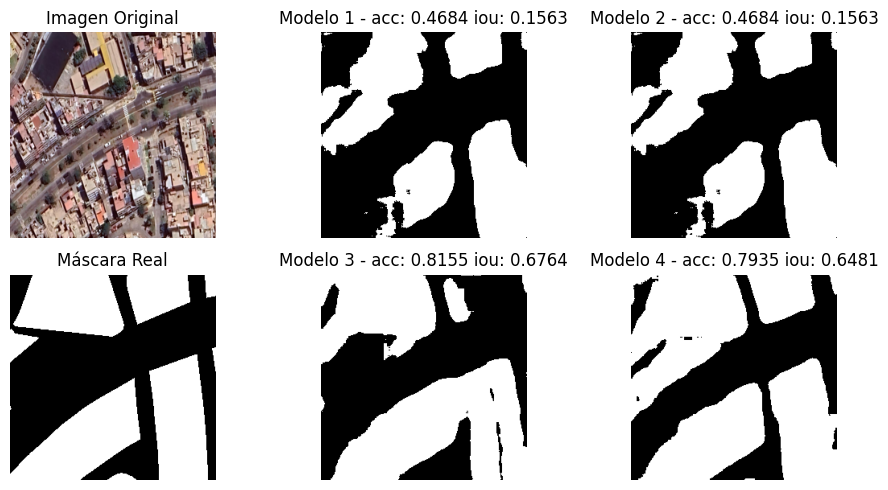

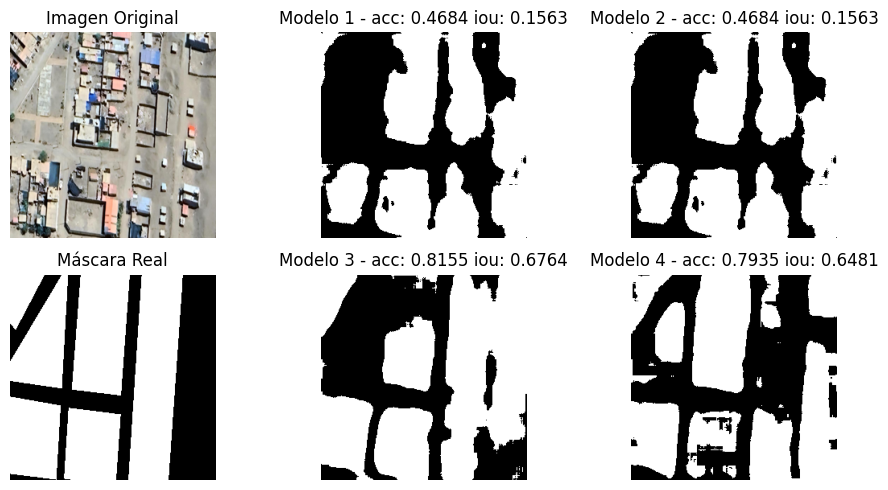

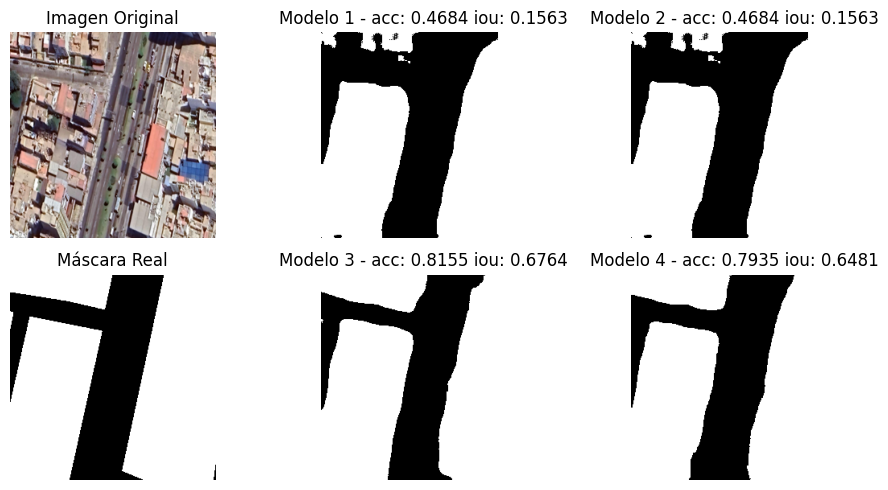

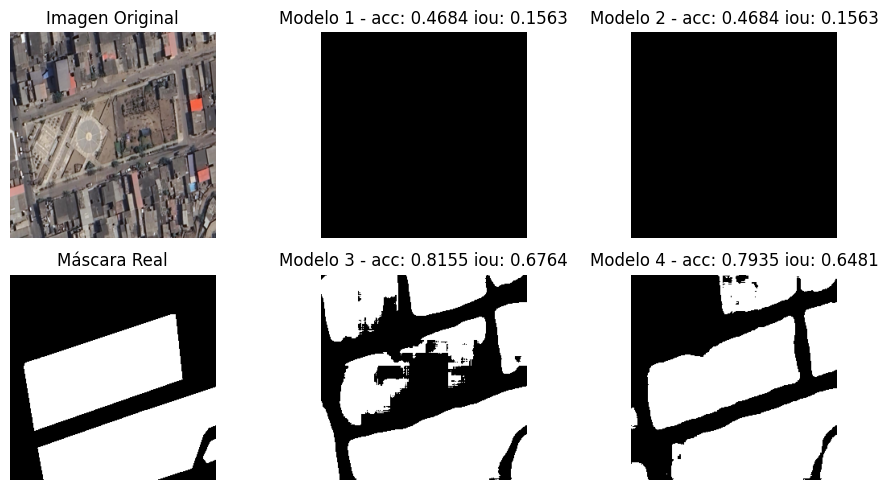

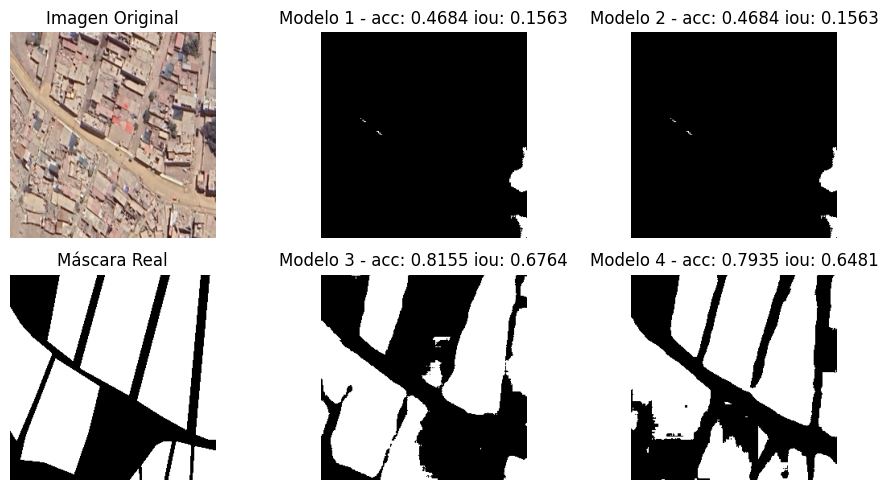

...

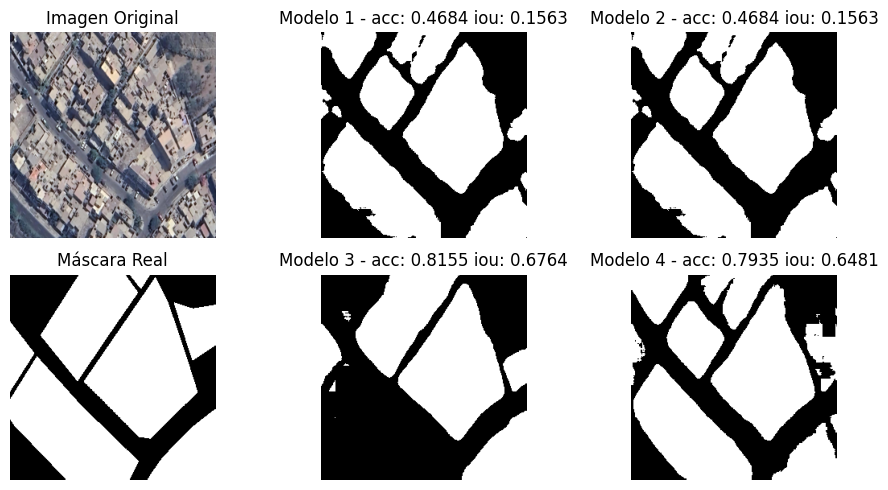

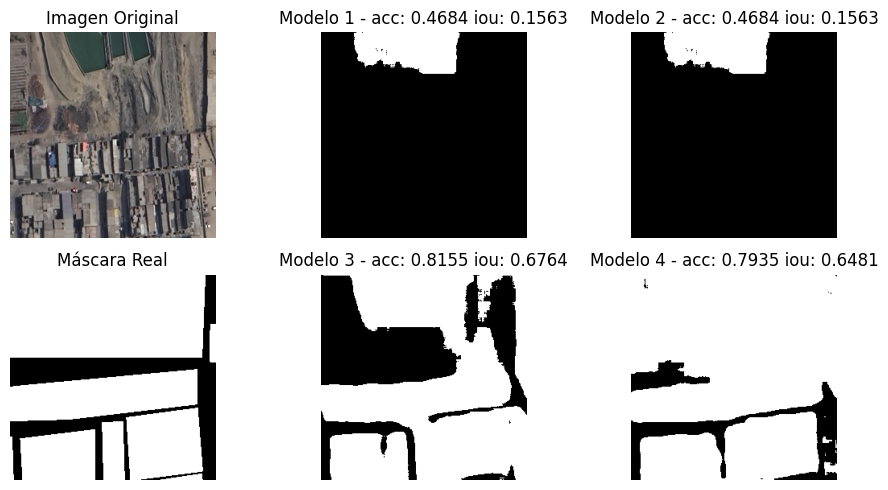

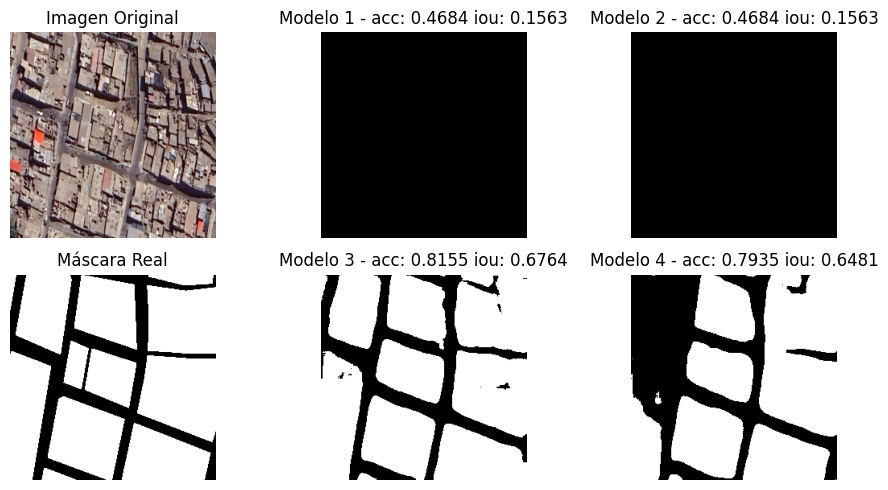

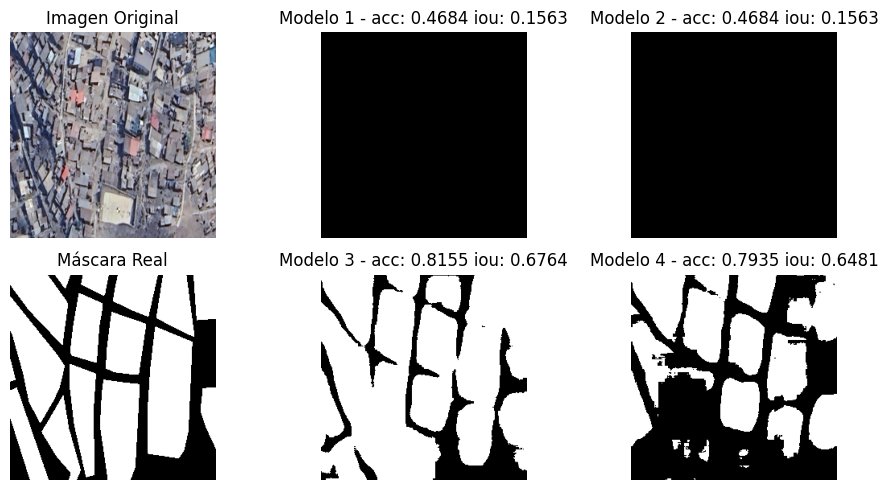

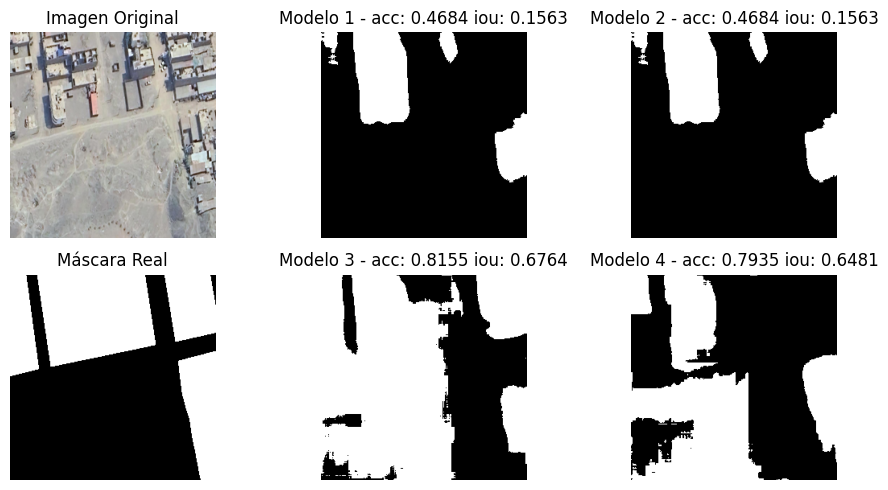

In [63]:
for i in range(100):
    grafico(i)